## Integration & Annotation

importing necessary libraries

In [1]:
import scanpy as sc
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
#%pip install celltypist scvi-tools hyperopt "ray[tune]"

In [2]:
import warnings
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", RuntimeWarning)

#### 1. Integrating and Annotating with Celltypist

In this step, I will integrate a reference dataset into the existing AnnData object. This will allow us to annotate the cells in the dataset by using **Celltypist**, improving the identification of specific cell types.

**Celltypist** is a tool designed for automated cell type annotation using a large reference of curated cell type signatures. It facilitates rapid and scalable annotation of single-cell RNA-seq data, leveraging pre-trained models to classify cells into known types based on their gene expression profiles.

In [3]:
import celltypist
from celltypist import models

In [4]:
models.get_all_models()

['Cells_Intestinal_Tract.pkl',
 'Developing_Human_Hippocampus.pkl',
 'Immune_All_Low.pkl',
 'Developing_Mouse_Brain.pkl',
 'COVID19_HumanChallenge_Blood.pkl',
 'Human_Colorectal_Cancer.pkl',
 'Developing_Mouse_Hippocampus.pkl',
 'Developing_Human_Organs.pkl',
 'Healthy_Human_Liver.pkl',
 'Adult_Human_MTG.pkl',
 'Adult_Human_Skin.pkl',
 'Healthy_Mouse_Liver.pkl',
 'Fetal_Human_Retina.pkl',
 'Developing_Human_Thymus.pkl',
 'Mouse_Postnatal_DentateGyrus.pkl',
 'Developing_Human_Gonads.pkl',
 'Developing_Human_Brain.pkl',
 'Cells_Human_Tonsil.pkl',
 'Mouse_Whole_Brain.pkl',
 'Adult_CynomolgusMacaque_Hippocampus.pkl',
 'Mouse_Dentate_Gyrus.pkl',
 'Human_Developmental_Retina.pkl',
 'Human_Longitudinal_Hippocampus.pkl',
 'Mouse_Isocortex_Hippocampus.pkl',
 'Autopsy_COVID19_Lung.pkl',
 'Adult_COVID19_PBMC.pkl',
 'Cells_Fetal_Lung.pkl',
 'Human_IPF_Lung.pkl',
 'Adult_Human_PancreaticIslet.pkl',
 'Cells_Adult_Breast.pkl',
 'Immune_All_High.pkl',
 'Lethal_COVID19_Lung.pkl',
 'Human_PF_Lung.pkl',


I have decided to use Immune_All_Low.pkl to help identify the immune cells since we're looking for macrophages subtypes.

In [ ]:
ref_model = models.Model.load(model='Immune_All_Low.pkl')

This function predicts cell types for a given `AnnData` object (`adata`) using a pre-trained reference model (`ref_model`) from the CellTypist package.

- **Steps**:
  1. **Gene Filtering**: Filters out genes that are not expressed in at least 10 cells using `sc.pp.filter_genes()`. This helps focus on informative genes for cell type prediction.
  
  2. **Normalization**: Normalizes the total counts for each cell to a target sum of 10,000 with `sc.pp.normalize_total()`, ensuring comparability across cells.

  3. **Log Transformation**: Applies a log transformation (`sc.pp.log1p()`) to the normalized data to stabilize variance and approximate a normal distribution.

  4. **Sparse to Dense Conversion (Optional)**: The code includes a commented-out line to convert the sparse matrix to a dense format. This is typically avoided for memory considerations in large datasets.

  5. **Cell Annotation**: Uses the `celltypist.annotate()` function with the reference model to predict cell types for the cells in the `AnnData` object, applying majority voting.

  6. **Conversion to AnnData**: Converts the predictions into an `AnnData` object format.

  7. **Store Predictions**: Adds the predicted labels (`predicted_labels`) and their corresponding confidence scores (`conf_score`) to the original `adata` object’s `.obs` attribute, ensuring that the indices align.

  8. **Return Observations**: Returns the updated observations (`obs`) of the modified `AnnData` object containing the predicted cell type labels and confidence scores.

This function prepares the data for cell type classification and integrates the predictions into the original dataset for further analysis.


In [24]:
# function to predict cells using the ref model
'''
Courtesy: https://www.sanbomics.com/teaching
'''

def predict_cells(adata):
    # Step 1: Filter genes to keep only those that are expressed in at least 10 cells
    sc.pp.filter_genes(adata, min_cells=10)
    
    # Step 2: Normalize the total count for each cell to a target sum of 10,000
    sc.pp.normalize_total(adata, target_sum=1e4)
    
    # Step 3: Log-transform the normalized data to stabilize variance and make the data more normally distributed
    sc.pp.log1p(adata)

    # Step 4 (optional): Convert sparse matrix to a dense format, if needed
    # adata.X = adata.X.toarray()  # won't do it for memory considerations

    # Step 5: Use the trained CellTypist model to annotate the cells in the AnnData object
    predictions = celltypist.annotate(adata, model=ref_model, majority_voting=False)
    
    # Step 6: Convert the predictions back to an AnnData object
    predictions_adata = predictions.to_adata()
    
    # Step 7: Add the predicted labels and their corresponding confidence scores to the original AnnData object
    #adata.obs['low_label'] = predictions_adata.obs.loc[adata.obs.index, 'predicted_labels']
    #adata.obs['low_score'] = predictions_adata.obs.loc[adata.obs.index, 'conf_score'] #'conf_score' confidence score

    
    adata.obs['low_label'] = pd.Series(predictions_adata.obs['predicted_labels'].values, index=adata.obs.index)
    adata.obs['low_score'] = pd.Series(predictions_adata.obs['conf_score'].values, index=adata.obs.index)

    # Step 8: Return the observations (obs) of the modified AnnData object
    return adata.obs


In [ ]:
# here we're basically collecting/loading all the Anndata objects in one list to go over them with the function we did before 

adatas = [sc.read_h5ad('preprocessed/' + x) for x in os.listdir('preprocessed/')]

In [31]:
predictions = [predict_cells(ad.copy()) for ad in human_adatas]

🔬 Input data has 1366 cells and 16053 genes
🔗 Matching reference genes in the model
🧬 4649 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🔬 Input data has 4941 cells and 22065 genes
🔗 Matching reference genes in the model
🧬 5127 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🔬 Input data has 1747 cells and 15273 genes
🔗 Matching reference genes in the model
🧬 4528 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🔬 Input data has 434 cells and 12128 genes
🔗 Matching reference genes in the model
🧬 3876 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🔬 Input data has 2245 cells and 15151 genes
🔗 Matching reference genes in the model
🧬 4541 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🔬 Input data has 8006 cells and 22181 genes
🔗 Matching reference genes in the model
🧬 5157 

In [23]:
print(human_adata.obs.index.duplicated().any())

True


In [25]:
predictions_human_adata = [predict_cells(human_adata.copy())]

🔬 Input data has 191378 cells and 10444 genes
🔗 Matching reference genes in the model
🧬 3525 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!


In [32]:
# we then concatenate the prediction results, extracting the 'low_label' and 'low_score' columns into a Pandas DataFrame named 'predictions_human'. 
# this DataFrame will be used later to integrate cell type predictions into the main AnnData object.

predictions_human = pd.concat(predictions)[['low_label', 'low_score']]
predictions_human

,low_label,low_score
AAAAATGACGCA,DC,0.134170
AAAAGGAAAGAA,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Fibroblasts,1.000000
AAAAGTTATGAT,Fibroblasts,0.862300
AAAATCGGTCCA,Fibroblasts,0.999521
...,...,...
TTTGTTGGTAATGCGG,Epithelial cells,0.999039
TTTGTTGGTCGTGTTA,Endothelial cells,0.997817
TTTGTTGGTTCTCTCG,Endothelial cells,1.000000
TTTGTTGTCGGCTGAC,Fibroblasts,1.000000


In [33]:
# the 'predictions_human' DataFrame is saved to a CSV file for later use. The code then concatenates a list of AnnData objects ('adatas') 
# into a single object named 'adata'. 
# Displaying 'adata.obs' shows the metadata associated with each cell in the combined dataset.

predictions_human.to_csv('PREDICTIONS_HUMAN.csv')

In [19]:
adata = sc.concat(adatas)
adata.obs

AnnData object with n_obs × n_vars = 392614 × 6
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score'

In [40]:
adatas[17].obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score
AAAACGAGCTCN,Hs_SAT_SVF_239-1A-1,771,771,6.648985,1189.0,7.081708,20.941968,2.607233,5.046257,0.0,True,0.0,0.376896
AAAATGCAGCGC,Hs_SAT_SVF_239-1A-1,571,571,6.349139,768.0,6.645091,14.322917,1.041667,5.468750,0.0,False,0.0,0.423178
AAACAGCTCAGA,Hs_SAT_SVF_239-1A-1,395,395,5.981414,523.0,6.261492,19.311663,1.338432,6.500956,0.0,False,0.0,0.010099
AAACATGCGCGG,Hs_SAT_SVF_239-1A-1,296,296,5.693732,365.0,5.902633,20.821918,1.095890,3.287671,0.0,True,0.0,0.000543
AAACCGAGCCTN,Hs_SAT_SVF_239-1A-1,522,522,6.259581,740.0,6.608001,21.486486,1.621622,5.540540,0.0,True,0.0,3.216886
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGCCTTGATT,Hs_SAT_SVF_239-1A-1,303,303,5.717028,365.0,5.902633,16.164384,2.739726,6.575342,0.0,True,0.0,0.010099
TTTGGATGTGCN,Hs_SAT_SVF_239-1A-1,219,219,5.393628,264.0,5.579730,21.969697,0.378788,1.515152,0.0,True,0.0,0.456342
TTTGTAATGCGN,Hs_SAT_SVF_239-1A-1,267,267,5.590987,323.0,5.780744,20.433437,2.476780,3.095975,0.0,False,0.0,0.004271
TTTGTCCGATCN,Hs_SAT_SVF_239-1A-1,642,642,6.466145,841.0,6.735780,13.674197,2.021403,9.750297,0.0,False,0.0,0.010099


----

At this point I realised a big difference in gene expression of the human and mouse samples so I've decided to separate them and only work on
the human samples since the dataset relatively big

In [5]:
# separating human from mouse Anndatas
human_adatas = []
mouse_adatas = []

# iterating through each AnnData object in the list
for ad in adatas:
    # filtering for human samples (those starting with 'Hs')
    if (ad.obs['Sample'].str.startswith('Hs')).any():
        human_adatas.append(ad[ad.obs['Sample'].str.startswith('Hs'), :])
    
    # filtering for mouse samples (those starting with 'Mm')
    if (ad.obs['Sample'].str.startswith('Mm')).any():
        mouse_adatas.append(ad[ad.obs['Sample'].str.startswith('Mm'), :])

# checking the number of AnnData objects filtered
print(f"Number of human AnnData objects: {len(human_adatas)}")
print(f"Number of mouse AnnData objects: {len(mouse_adatas)}")


Number of human AnnData objects: 60
Number of mouse AnnData objects: 26


In [6]:
human_adata = sc.concat(human_adatas)
human_adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score'

In [9]:
sc.write('human_adata.h5ad', human_adata)
# saving current progress

In [ ]:
#mouse_adata = sc.concat(mouse_adatas)
#mouse_adata
# not enough RAM to load it as well, will leave it for now

In [12]:
predictions = pd.read_csv('PREDICTIONS.csv')
predictions.head()

,Unnamed: 0,low_label,low_score
0,AACCTTTAGGCCACCT,Double-positive thymocytes,0.002575
1,AAAGAACCATCGAAGG,Double-positive thymocytes,0.002110
2,TTCTAGTCAACCGCTG,Double-positive thymocytes,0.001856
3,AACAACCCAACCGCCA,Double-positive thymocytes,0.002414
4,GCCCGAACACGCTGCA,Epithelial cells,0.003879


In [13]:
human_adata1 = human_adata.copy()
human_adata1

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score'

In [34]:
predictions_human.head()

,low_label,low_score
AAAAATGACGCA,DC,0.134170
AAAAGGAAAGAA,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Fibroblasts,1.000000
AAAAGTTATGAT,Fibroblasts,0.862300
AAAATCGGTCCA,Fibroblasts,0.999521


---

### Merging Predictions

In [24]:
human_adata1.obs.shape

(191378, 13)

In [ ]:
# I encountered here the problem that the df made by my celltypist model has a different size than my Anndata so the merging of predictions has failed for now

human_adata1.obs = human_adata1.obs.merge(predictions_human, left_index=True, right_index=True, how='left')

In [40]:
# print cells and prediction indices to tackle the problem

print(len(human_adata1.obs.index))
print(len(predictions_human.index))
print(len(set(human_adata1.obs.index) & set(predictions_human.index)))

191378
191378
188572


In [45]:
common_indices = list(set(human_adata1.obs.index) & set(predictions_human.index))

# Filter human_adata1
human_adata2 = human_adata1[human_adata1.obs.index.isin(common_indices)].copy()

# Filter predictions_human
predictions_human_filtered = predictions_human.loc[common_indices]

# Verify the sizes
print("human_adata2 observations:", len(human_adata2.obs))
print("predictions_human_filtered rows:", len(predictions_human_filtered))
print("common indices:", len(common_indices))

human_adata2 observations: 191378
predictions_human_filtered rows: 191378
common indices: 188572


In [9]:
predictions_human = pd.read_csv('PREDICTIONS_HUMAN.csv', index_col='Unnamed: 0')
predictions_human.head()

,low_label,low_score
AAAAATGACGCA,DC,0.134170
AAAAGGAAAGAA,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Fibroblasts,1.000000
AAAAGTTATGAT,Fibroblasts,0.862300
AAAATCGGTCCA,Fibroblasts,0.999521


In [10]:
predictions_human.shape

(191378, 2)

In [13]:
human_adata= sc.read_h5ad('human_adata.h5ad')
human_adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score'

In [14]:
human_adata1 = human_adata.copy()

In [46]:
# Reorder predictions_human to match human_adata1
predictions_human = predictions_human.loc[human_adata1.obs.index]

# Check if the shapes are now aligned
print(human_adata1.obs.shape)
print(predictions_human.shape)



(191378, 13)
(197182, 2)


In [63]:
# so a while later I discovered that the problem would be solved if I reset both of the indices and then removed the background uncommon barcodes
# I don't really know where the problem was, maybe a conflict between scanpy and pandas

# Reset index for both DataFrames to ensure proper filtering
human_adata1.obs.reset_index(drop=False, inplace=True)  # keeping the index as a column
predictions_human.reset_index(drop=False, inplace=True)  # keeping the index as a column

In [64]:
merged_df = pd.merge(human_adata1.obs, predictions_human, left_on='index', right_on='index', how='inner')


In [68]:
print("Shape of merged_df:", merged_df.shape)
print("Shape of human_adata1.obs:", human_adata1.obs.shape)


Shape of merged_df: (210422, 16)
Shape of human_adata1.obs: (191378, 14)


In [71]:
merged_df.reset_index(drop=False, inplace=True)  # Keep the current index as a column


In [72]:
# Check the indices of human_adata1.obs
print("Index of human_adata1.obs:", human_adata1.obs.index)

# Check the indices of merged_df
print("Index of merged_df:", merged_df['index'].unique())  # Use the column name after reset


Index of human_adata1.obs: RangeIndex(start=0, stop=191378, step=1)
Index of merged_df: ['AAAAATGACGCA' 'AAAAGGAAAGAA' 'AAAAGGCGACGT' ... 'TTTGTTGGTTCTCTCG'
 'TTTGTTGTCGGCTGAC' 'TTTGTTGTCGGTAGGA']


In [82]:
#human_adata1.obs.reset_index(drop=False, inplace=True)
#human_adata1.obs.set_index('index', inplace=True)

human_adata1.obs.head()

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score
index,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913


In [86]:
merged_df.set_index('index', inplace=True)
merged_df.head()

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label,low_score
index,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521


In [87]:
# saving the merged df

merged_df.to_csv('MERGED_DF.csv')

In [97]:
human_adata1.obs = human_adata1.obs.merge(predictions_human, left_index=True, right_index=True)


In [100]:
human_adata1.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,index,low_label_x,low_score_x,low_label_y,low_score_y
index,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,NaN,NaN,NaN,DC,0.134170
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,NaN,NaN,NaN,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,NaN,NaN,NaN,Fibroblasts,1.000000
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,NaN,NaN,NaN,Fibroblasts,0.862300
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,NaN,NaN,NaN,Fibroblasts,0.999521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,False,0.0,1.491288,NaN,NaN,NaN,Epithelial cells,0.999039
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,True,0.0,0.003380,NaN,NaN,NaN,Endothelial cells,0.997817
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,True,0.0,0.001058,NaN,NaN,NaN,Endothelial cells,1.000000


In [ ]:
# dropping columns with any NaN values
human_adata1.obs = human_adata1.obs.dropna(axis=1, how='any')

In [102]:
# Verify the result
human_adata1.obs.head()

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label_y,low_score_y
index,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521


In [103]:
human_adata1.obs.rename(columns={'low_label_y': 'low_label', 'low_score_y': 'low_score'}, inplace=True)
human_adata1.obs

/tmp/ipykernel_307690/454148554.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  human_adata1.obs.rename(columns={'low_label_y': 'low_label', 'low_score_y': 'low_score'}, inplace=True)


,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label,low_score
index,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,False,0.0,1.491288,Epithelial cells,0.999039
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,True,0.0,0.003380,Endothelial cells,0.997817
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,True,0.0,0.001058,Endothelial cells,1.000000


In [104]:
human_adata1.write_h5ad('human_prediction_merged.h5ad')

/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1209: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[key] = c
... storing 'low_label' as categorical


---------------------

### Hyperparameter Tuning

In this step, I will perform hyperparameter tuning using **scVI-tools** to optimize the performance of the model on my single-cell data. To handle the tuning efficiently, I utilize ray for parallel computation.

- scVI-tools provides a built-in `ModelTuner` class to tune models automatically.
- ray and ray[tune] are used to scale hyperparameter search across multiple trials efficiently.

In [3]:
adata = sc.read_h5ad('human_prediction_merged.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score'

In [15]:
from scvi.autotune import ModelTuner
import ray
from ray import tune

In [6]:
sc.pp.filter_genes(adata, min_cells= 50)

In [14]:
adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels'
    var: 'n_cells'
    uns: '_scvi_uuid', '_scvi_manager_uuid'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'

In [17]:
model_cls = scvi.model.SCVI
ray.shutdown()
ray.init(object_store_memory= 20 * 1024 ** 3) # 20 GiB in bytes

model_cls.setup_anndata(adata, categorical_covariate_keys= ['Sample'],
                        continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo'])

tuner = ModelTuner(model_cls)

2024-10-15 13:45:54,603	INFO worker.py:1786 -- Started a local Ray instance.
(_trainable pid=348668) /home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/ray/tune/integration/pytorch_lightning.py:198: `ray.tune.integration.pytorch_lightning.TuneReportCallback` is deprecated. Use `ray.tune.integration.pytorch_lightning.TuneReportCheckpointCallback` instead.
(_trainable pid=348668) GPU available: False, used: False
(_trainable pid=348668) TPU available: False, using: 0 TPU cores
(_trainable pid=348668) HPU available: False, using: 0 HPUs
(_trainable pid=348668) /home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=15` in the `DataLoader` to improve performance.
(_trainable pid=348668) /home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/si

In [18]:
tuner.info()

ModelTuner registry for SCVI

                  Tunable hyperparameters                  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━┓
┃      Hyperparameter      ┃ Default value ┃    Source    ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━┩
│         n_hidden         │      128      │     VAE      │
│         n_latent         │      10       │     VAE      │
│         n_layers         │       1       │     VAE      │
│       dropout_rate       │      0.1      │     VAE      │
│        dispersion        │     gene      │     VAE      │
│     log_variational      │     True      │     VAE      │
│     gene_likelihood      │     zinb      │     VAE      │
│   latent_distribution    │    normal     │     VAE      │
│    encode_covariates     │     False     │     VAE      │
│ deeply_inject_covariates │     True      │     VAE      │
│      use_batch_norm      │     both      │     VAE      │
│      use_layer_norm      │     none      │     VAE      │
│  use_observed_lib_size   │     True      │     VAE      │
│      var_activation      │     None      │     VAE      │
│        optimizer         │     Adam      │ TrainingPlan │
│            lr            │     0.001     │ TrainingPlan │
│       weight_decay       │     1e-06     │ TrainingPlan │
│           eps            │     0.01      │ TrainingPlan │
│    n_steps_kl_warmup     │     None      │ TrainingPlan │
│    n_epochs_kl_warmup    │      400      │ TrainingPlan │
│   reduce_lr_on_plateau   │     False     │ TrainingPlan │
│        lr_factor         │      0.6      │ TrainingPlan │
│       lr_patience        │      30       │ TrainingPlan │
│       lr_threshold       │      0.0      │ TrainingPlan │
│          lr_min          │       0       │ TrainingPlan │
│      max_kl_weight       │      1.0      │ TrainingPlan │
│      min_kl_weight       │      0.0      │ TrainingPlan │
│        batch_size        │      128      │     SCVI     │
└──────────────────────────┴───────────────┴──────────────┘

       Available metrics        
┏━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┓
┃     Metric      ┃    Mode    ┃
┡━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━┩
│ validation_loss │    min     │
└─────────────────┴────────────┘

                         Default search space                         
┏━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Hyperparameter ┃ Sample function ┃  Arguments  ┃ Keyword arguments ┃
┡━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│    n_hidden    │     choice      │ [[64, 128]] │        {}         │
└────────────────┴─────────────────┴─────────────┴───────────────────┘

### Model Tuner Setup for Hyperparameter Optimization

This code initializes a **ModelTuner** instance to perform hyperparameter tuning for a given model class (`model_cls`). It defines a **search space** for various hyperparameters that will be explored during the tuning process.

- **Parameters** in the Search Space:
  - **`n_hidden`**: The number of hidden units in the model. This parameter is set to choose among the values `[92, 128, 192, 256]`.
  
  - **`n_latent`**: The dimensionality of the latent space. The choices for this parameter include `[10, 20, 30, 40, 50, 60]`.
  
  - **`n_layers`**: The number of layers in the model, with options of `[1, 2, 3]`. This determines the depth of the neural network architecture.
  
  - **`lr`**: The learning rate for the optimization algorithm. This is set to be sampled from a log-uniform distribution between `1e-4` and `1e-2`, allowing exploration of a wide range of learning rates.
  
  - **`gene_likelihood`**: Specifies the likelihood function to be used for modeling gene expression, with choices between `'nb'` (negative binomial) and `'zinb'` (zero-inflated negative binomial). This parameter influences how the model handles overdispersion and zero inflation commonly found in single-cell RNA-seq data.

This setup prepares the tuning process to efficiently explore various configurations of the model, aiming to find the optimal hyperparameters that yield the best performance on the given task.


In [19]:
# so there are many parameter in the tuner as we can see, we can change them based on our data
# the default parameters of SCVI do a good job
# we have to define the search space for the model
tuner = ModelTuner(model_cls)

search_space = {
    'n_hidden': tune.choice([92, 128, 192, 256]),
    'n_latent': tune.choice([10, 20, 30, 40, 50, 60]),
    'n_layers': tune.choice([1, 2, 3]),
    'lr': tune.loguniform(1e-4, 1e-2),
    'gene_likelihood': tune.choice(['nb', 'zinb'])
}

In [20]:
results = tuner.fit(adata, metric= 'validation_loss',
                    search_space= search_space,
                    num_samples= 100,
                    max_epochs= 20)

2024-10-15 13:47:27,813	INFO tune.py:616 -- [output] This uses the legacy output and progress reporter, as Jupyter notebooks are not supported by the new engine, yet. For more information, please see https://github.com/ray-project/ray/issues/36949
2024-10-15 22:41:17,980	INFO tune.py:1009 -- Wrote the latest version of all result files and experiment state to '/media/adlunglab/DataDrive/Projects/mohamed/sc_atlas/scvi_log/autotune/2024-10-15_13-47-27_scvi' in 2.6574s.
2024-10-15 22:41:17,991	INFO tune.py:1041 -- Total run time: 32030.18 seconds (32027.50 seconds for the tuning loop).


In [21]:
with open('tuning_results.txt', 'w') as f:
    f.write(str(results)) 

In [23]:
# so we basically trained the model above 100 times and we want to catch the lowest validation loss, so we can loop over the list to get the 
# lowest one

type(results)

scvi.autotune._manager.TuneAnalysis

### Best Validation Loss Selection

This cell iterates through the results of a hyperparameter tuning process to identify the best-performing model based on validation loss.

- **Initialization**:
  - **`best_vl`**: This variable is initialized to `10000`, representing a high initial value for validation loss, effectively acting as a placeholder to ensure that any actual validation loss encountered during iteration will be lower.
  - **`best_i`**: This variable is initialized to `0` and will store the index of the best-performing model found during the iteration.

- **Iteration**:
  - The loop iterates through each result in `results.results`, where `i` represents the index and `res` represents the individual result object.
  
  - Within the loop, the validation loss (`vl`) is extracted from the `res.metrics` dictionary using the key `'validation_loss'`.

- **Comparison**:
  - A conditional check compares the current validation loss (`vl`) to `best_vl`. If `vl` is less than `best_vl`, it indicates that a better-performing model has been found.
  
  - If a better model is identified, `best_vl` is updated to the current validation loss (`vl`), and `best_i` is updated to the current index (`i`).

This process results in `best_i` holding the index of the model that achieved the lowest validation loss throughout the tuning process, which can be used later for further evaluation or inference.


In [25]:
best_vl = 10000
best_i = 0

for i, res in enumerate(results.results):
    vl = res.metrics['validation_loss']
    
    if vl < best_vl:
        best_vl = vl
        best_i = i

In [26]:
best_i

69

In [27]:
best_vl

3807.345458984375

In [28]:
results.results[best_i]

Result(
  metrics={'validation_loss': 3807.345458984375},
  path='/media/adlunglab/DataDrive/Projects/mohamed/sc_atlas/scvi_log/autotune/2024-10-15_13-47-27_scvi/_trainable_200921d5_70_gene_likelihood=nb,lr=0.0006,n_hidden=256,n_latent=60,n_layers=2_2024-10-15_19-42-52',
  filesystem='local',
  checkpoint=None
)

In [29]:
# Voilà! now in the best_i above that we can use in our SCVI model setup for integration model training

scvi.model.SCVI.setup_anndata(adata, categorical_covariate_keys= ['Sample'],
                              continuous_covariate_keys= ['pct_counts_mt', 'pct_counts_ribo'])

In [30]:
# model initialization
model = scvi.model.SCVI(adata, n_hidden= 256, n_latent= 60, n_layers= 2, gene_likelihood= 'nb')

In [31]:
# we need to specify learning rate, we can also get it from our tuning result

kwargs = { 'lr':0.0006 }

In [32]:
# model training

model.train(max_epochs= 200, early_stopping= True, plan_kwargs= kwargs)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Epoch 200/200: 100%|█| 200/200 [6:08:12<00:00, 111.90s/it, v_num=1, train_loss_s

`Trainer.fit` stopped: `max_epochs=200` reached.


Epoch 200/200: 100%|█| 200/200 [6:08:12<00:00, 110.46s/it, v_num=1, train_loss_s


In [34]:
model.save('the_model')

In [37]:
model.history

{'kl_weight':       kl_weight
 epoch          
 0           0.0
 1        0.0025
 2         0.005
 3        0.0075
 4          0.01
 ...         ...
 195      0.4875
 196        0.49
 197      0.4925
 198       0.495
 199      0.4975
 
 [200 rows x 1 columns],
 'train_loss_step':       train_loss_step
 epoch                
 0         3949.514648
 1         3746.750977
 2         3697.058594
 3         3893.553467
 4         3532.881592
 ...               ...
 195       3966.496582
 196       3923.302246
 197       3686.052002
 198       3224.838867
 199       3646.513184
 
 [200 rows x 1 columns],
 'validation_loss':       validation_loss
 epoch                
 0         3935.332275
 1         3893.722168
 2         3874.111572
 3         3864.266602
 4         3856.962402
 ...               ...
 195        3846.22998
 196       3846.313965
 197       3846.418213
 198       3846.435303
 199       3846.562256
 
 [200 rows x 1 columns],
 'elbo_validation':       elbo_validation
 epoch 

In [36]:
# let's look how the training did

y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()

In [40]:
y

3836.188232421875

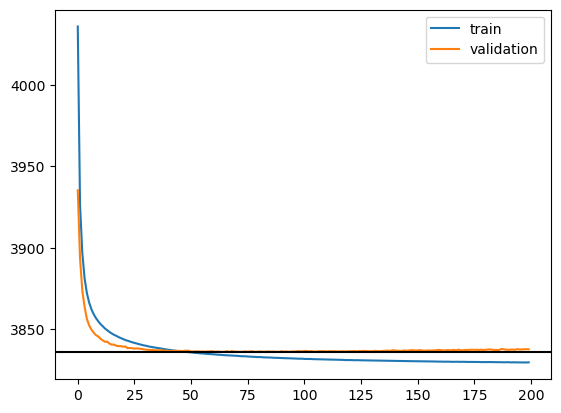

In [42]:
# and we can plot the training and validation loss over time

plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label='train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label='validation')

plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [43]:
# Voilà, looking good. It could have stopped sooner but as long as it's not a pumpy road at the validation curve
# it means it's unlickely to be overfitted

adata.write_h5ad('temp.h5ad')

In [44]:
# we're going to be using the model now as an integration method, so we need the embeddings
# the latent representation from our model which we will use to get the neighbors and find the clusters

adata.obsm['X_scVI'] = model.get_latent_representation()

In [45]:
adata.obsm['X_scVI'].shape

(191378, 10)

In [ ]:
# calculating the neighbors

#os.environ['NUMBA_DISABLE_JIT'] = '1'
sc.pp.neighbors(adata, use_rep='X_scVI')
# got an error regarding Numba library and after 5 hours of debugging I decided to workaround with same algorithm using scikit learn

In [69]:
# saving the raw data in another layer called 'counts' untouched to use it later 

adata.layers['counts'] = adata.X.copy()

### Nearest Neighbors Computation and Connectivity Matrix Creation

This cell computes the nearest neighbors of cells adata and constructs distance and connectivity matrices. The goal is to facilitate downstream analyses such as clustering or visualization.

- **Imports**:
  - `NearestNeighbors` from `sklearn.neighbors`: Used to find the nearest neighbors based on a specified distance metric.
  - `scipy.sparse`: Provides functionality for sparse matrix operations.
  - `numpy`: Used for numerical operations.

- **Data Preparation**:
  - **`X`**: The cell embeddings are extracted from the AnnData object, specifically from `adata.obsm['X_scVI']`, which contains the low-dimensional representations of the cells.
  - **`n_neighbors`**: Set to `15`, specifying the number of nearest neighbors to find for each cell.

- **Nearest Neighbors Calculation**:
  - An instance of `NearestNeighbors` is created with the specified number of neighbors and the Euclidean distance metric.
  - The model is fitted on the embeddings `X`, and the `kneighbors` method is called to compute the distances and indices of the nearest neighbors.

- **Sparse Distance Matrix Creation**:
  - A sparse matrix `distances_sparse` is created to store the distances between cells. The structure is defined by the distances calculated and their respective neighbor indices.

- **Connectivity Matrix Creation**:
  - A copy of the distance matrix is made to create a connectivity matrix, where all non-zero entries are set to `1`, indicating a connection between neighbors.
  
- **Symmetrization of Matrices**:
  - The distance matrix is symmetrized by taking the minimum distance values between each pair of cells (i.e., for both `A to B` and `B to A`).
  - The connectivity matrix is updated to be symmetric by adding its transpose. Any entries greater than `1` are set to `1` to ensure a binary representation of connections.

- **Assignment to AnnData Object**:
  - The sparse distance and connectivity matrices are assigned to the AnnData object as `adata.obsp['distances']` and `adata.obsp['connectivities']`, respectively, for easy access during further analyses.

This process prepares the data for neighborhood-based analyses, which can help in tasks such as clustering, trajectory inference, or visualization in the single-cell RNA-seq context.


In [74]:
from sklearn.neighbors import NearestNeighbors
import scipy.sparse as sparse
import numpy as np

X = adata.obsm['X_scVI']
n_neighbors = 15  

# compute nearest neighbors
nn = NearestNeighbors(n_neighbors=n_neighbors, metric='euclidean', n_jobs=-1)
nn.fit(X)
distances, neighbors = nn.kneighbors()

# convert distances to a sparse matrix with correct shape
n_obs = X.shape[0]
distances_sparse = sparse.csr_matrix(
    (distances.flatten(), (np.repeat(np.arange(n_obs), n_neighbors), neighbors.flatten())),
    shape=(n_obs, n_obs)
)

# Create connectivities
connectivities = distances_sparse.copy()
connectivities.data = np.ones_like(connectivities.data)

# Symmetrize the matrices
distances_sparse = sparse.csr_matrix((np.minimum(distances_sparse.data, distances_sparse.T.data),
                                     distances_sparse.nonzero()),
                                     shape=distances_sparse.shape)
connectivities = connectivities + connectivities.T
connectivities.data[connectivities.data > 1] = 1

# Assign to adata
adata.obsp['distances'] = distances_sparse
adata.obsp['connectivities'] = connectivities

In [75]:
adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels'
    var: 'n_cells'
    uns: '_scvi_uuid', '_scvi_manager_uuid'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'X_scVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

Initializing and storing parameters related to the neighbors computation within the `uns` (unstructured) attribute of an AnnData object (`adata`). This organization allows for easy retrieval and reference of neighbor-related settings during downstream analyses.

- **Initialization**:
  - **`adata.uns['neighbors']`**: A new dictionary is created within the `uns` attribute to store neighbor-related parameters. This provides a structured way to keep track of different configurations and results associated with the neighbor calculations.

- **Parameter Storage**:
  - **`params`**: A subdictionary named `params` is created to hold specific parameters used during the neighbor computation:
    - **`'n_neighbors'`**: Set to `15`, indicating the number of nearest neighbors considered in the analysis.
    - **`'method'`**: Set to `'umap'`, which may refer to the method used for dimensionality reduction or visualization associated with the neighbors. This suggests that the neighbors are computed in the context of UMAP embeddings.

- **Key References**:
  - **`connectivities_key`**: This key is set to reference the connectivity matrix stored in `adata.obsp['connectivities']`, indicating where the connectivity information is stored.
  - **`distances_key`**: Similarly, this key references the distance matrix stored in `adata.obsp['distances']`.

By organizing these parameters in the AnnData object, the code enhances the reproducibility of the analysis and facilitates the interpretation of results, making it easier to track which settings were used in the neighbor computations during subsequent steps of the analysis pipeline.


In [79]:
adata.uns['neighbors'] = {}
adata.uns['neighbors']['params'] = {'n_neighbors': 15, 'method': 'umap'}
adata.uns['neighbors']['connectivities_key'] = 'connectivities'
adata.uns['neighbors']['distances_key'] = 'distances'

### Leiden Clustering

The function call `sc.tl.leiden(adata)` applies the Leiden algorithm for clustering the cells in the AnnData object (`adata`). The Leiden algorithm is a popular method for community detection in networks, and it is particularly suited for single-cell RNA sequencing data analysis due to its efficiency and ability to identify clusters of varying sizes.

- **Input**:
  - **`adata`**: This is the AnnData object containing single-cell gene expression data along with computed neighbors and embeddings.

- **Functionality**:
  - The Leiden algorithm works by optimizing modularity in a graph representation of the data, where cells are treated as nodes and edges represent similarities (e.g., computed from the nearest neighbors).
  - The algorithm iteratively refines clusters by detecting communities within the data, resulting in a partition of cells into distinct clusters based on their gene expression profiles.

- **Output**:
  - The resulting cluster labels are stored in `adata.obs['leiden']`, where each cell is assigned a label corresponding to its cluster.
  - This clustering result can be used for downstream analyses, such as differential expression analysis, visualization, or exploration of cell type heterogeneity.

By applying the Leiden clustering, researchers can identify distinct cell populations within the single-cell dataset, aiding in biological interpretations and further analyses.

In [81]:
sc.tl.leiden(adata)

In [82]:
sc.tl.umap(adata)

In [83]:
# now we have to normalize the cell counts, the default normalization method in scanpy is the right way to do it
# according to the latest methods comparison paper of 2023
# https://doi.org/10.1038/s41592-023-01814-1

sc.pp.normalize_total(adata)
sc.pp.log1p(adata)

In [84]:
adata.write_h5ad('temp1.h5ad')

In [96]:
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label,low_score,_scvi_batch,_scvi_labels,leiden
index,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170,0,0,3
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875,0,0,11
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000,0,0,5
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300,0,0,11
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,False,0.0,1.491288,Epithelial cells,0.999039,0,0,10
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,True,0.0,0.003380,Endothelial cells,0.997817,0,0,7
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,True,0.0,0.001058,Endothelial cells,1.000000,0,0,7


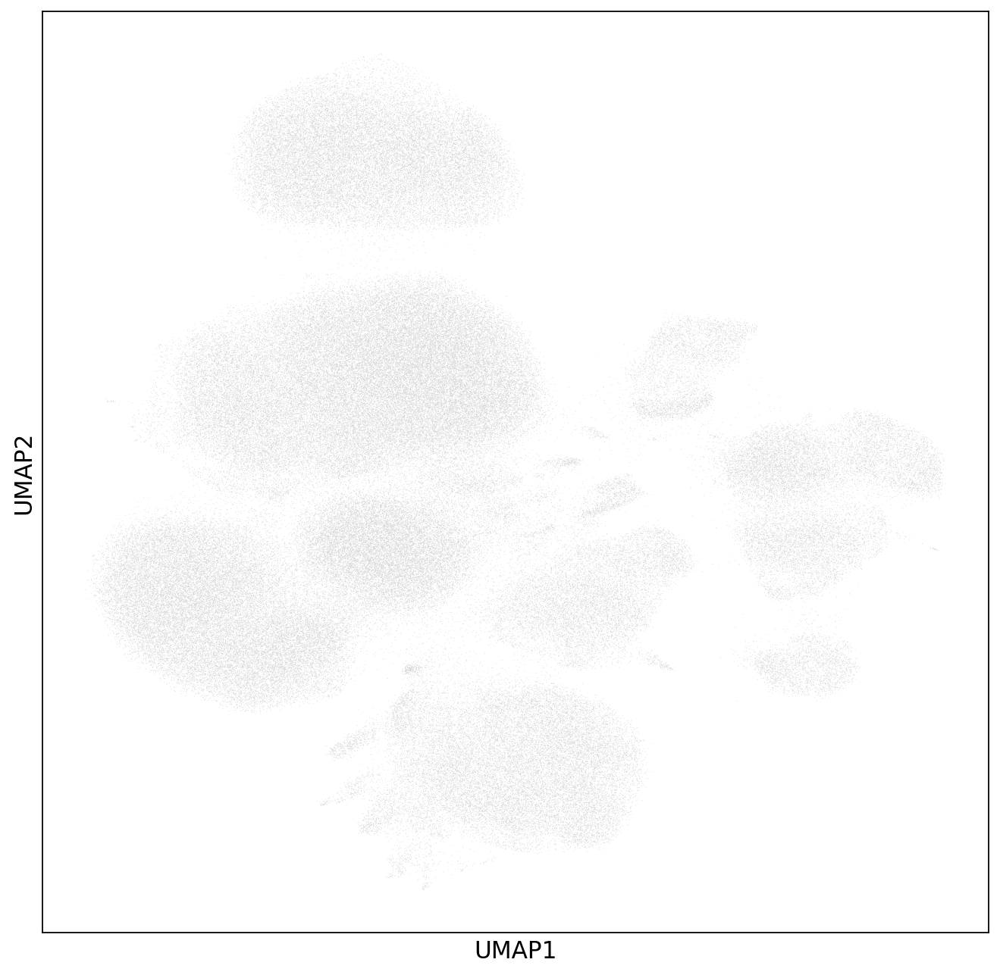

In [93]:
#sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata)


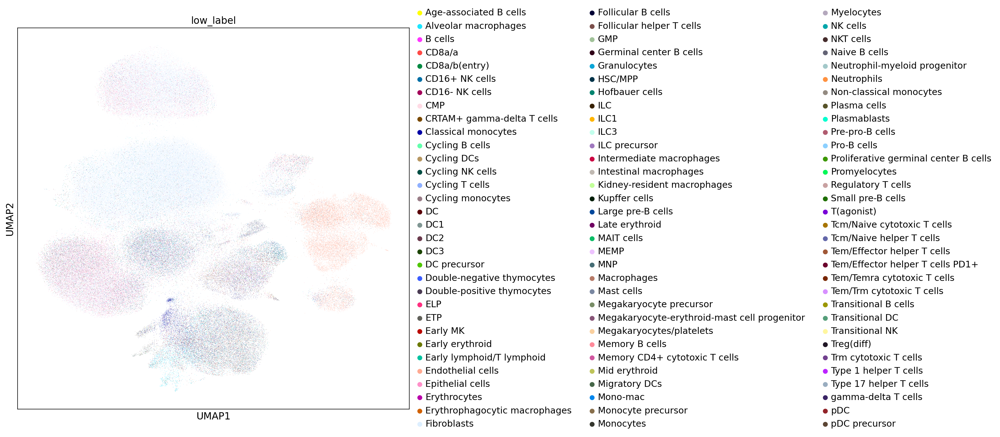

In [94]:
sc.pl.umap(adata, color=['low_label'])


In [99]:
#adata.obs['low_major'] = adata.obs.groupby('leiden')['low_label'].transform([lambda x: x.mode()][0])

In [103]:
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label,low_score,_scvi_batch,_scvi_labels,leiden
index,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170,0,0,3
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875,0,0,11
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000,0,0,5
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300,0,0,11
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521,0,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,False,0.0,1.491288,Epithelial cells,0.999039,0,0,10
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,True,0.0,0.003380,Endothelial cells,0.997817,0,0,7
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,True,0.0,0.001058,Endothelial cells,1.000000,0,0,7


In [115]:
sc.tl.leiden(adata, resolution=2.0, key_added='scvi_leiden')

In [ ]:
'''
from collections import Counter

def get_majority_label(group):
    return Counter(group).most_common(1)[0][0]

# grouping by leiden cluster and get the majority low_label
cluster_labels = adata.obs.groupby('scvi_leiden')['low_label'].apply(get_majority_label)

# adding the majority label to adata.obs
adata.obs['scvi_cluster_label'] = adata.obs['scvi_leiden'].map(cluster_labels)
'''

In [114]:
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,LAM_cells,doublet,doublet_score,low_label,low_score,_scvi_batch,_scvi_labels,leiden,scvi_leiden,scvi_cluster_label
index,,,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,True,0.0,0.430620,DC,0.134170,0,0,3,3,Intestinal macrophages
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,False,0.0,0.012130,Double-positive thymocytes,0.937875,0,0,11,11,Fibroblasts
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,True,0.0,0.083268,Fibroblasts,1.000000,0,0,5,5,Fibroblasts
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,False,0.0,0.000017,Fibroblasts,0.862300,0,0,11,11,Fibroblasts
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,True,0.0,0.043913,Fibroblasts,0.999521,0,0,5,5,Fibroblasts
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,False,0.0,1.491288,Epithelial cells,0.999039,0,0,10,10,Fibroblasts
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,True,0.0,0.003380,Endothelial cells,0.997817,0,0,7,7,Endothelial cells
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,True,0.0,0.001058,Endothelial cells,1.000000,0,0,7,7,Endothelial cells


[<Axes: title={'center': 'scvi_leiden'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'leiden'}, xlabel='UMAP1', ylabel='UMAP2'>]

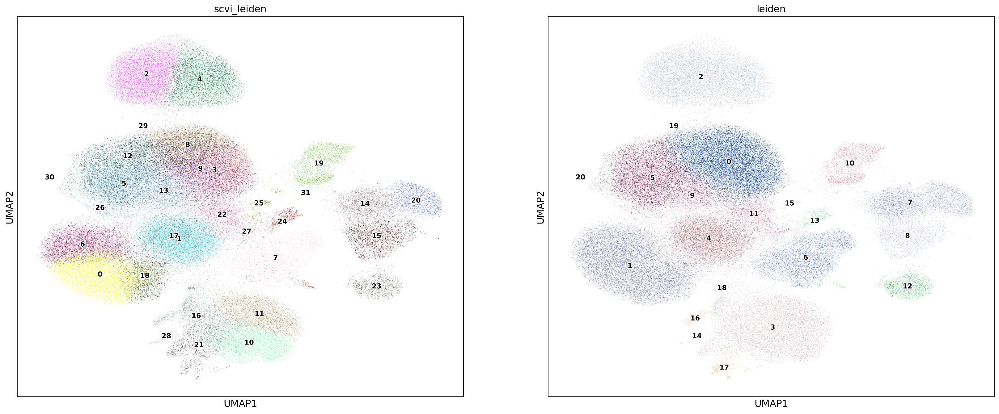

In [122]:
#sc.set_figure_params(figsize=(12, 10))
#fig, ax = plt.subplots(figsize=(15, 12))

sc.pl.umap(adata, color=['scvi_leiden', 'leiden'], show=False, legend_loc='on data', legend_fontsize=10, legend_fontoutline=2)
#sc.pl.umap(adata, color='scvi_cluster_label', ax=ax2, show=False, title='scVI Cluster Labels')

#plt.tight_layout()
#plt.show()

<Axes: title={'center': 'SCVI Leiden Clusters'}, xlabel='UMAP1', ylabel='UMAP2'>

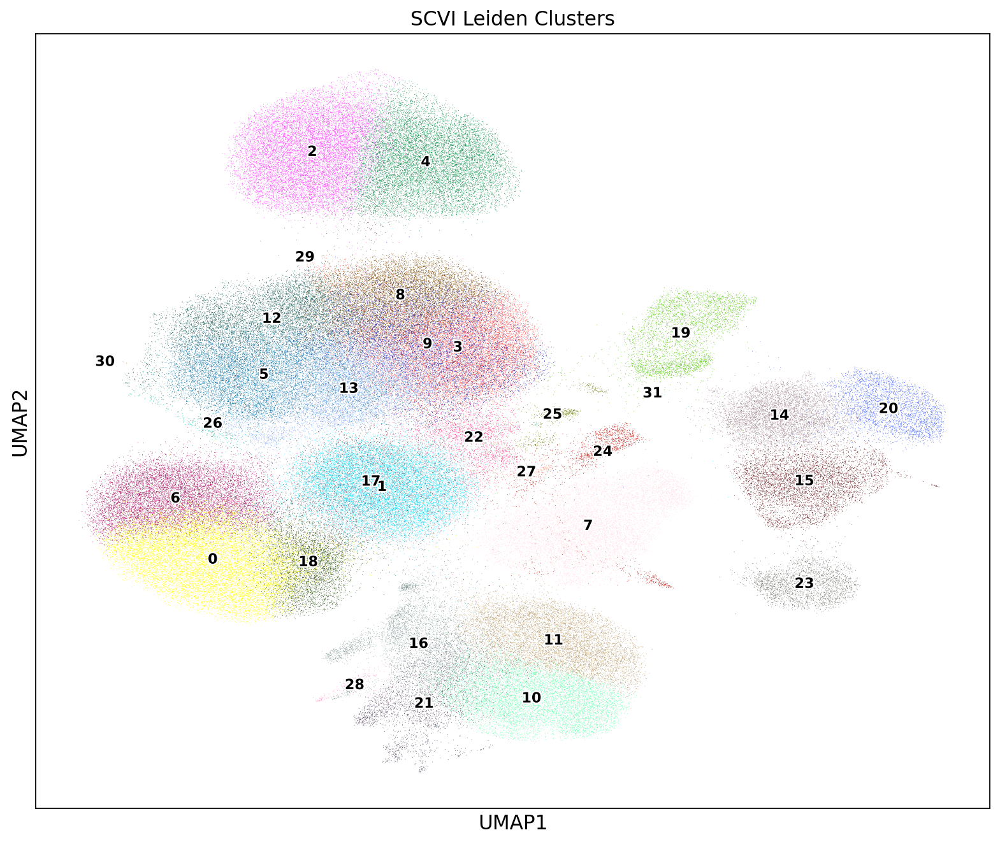

In [123]:
sc.pl.umap(adata, color='scvi_leiden', show=False, title='SCVI Leiden Clusters', legend_loc='on data', legend_fontsize=10, legend_fontoutline=2)
#sc.pl.umap(adata, color='scvi_cluster_label', ax=ax2, show=False, title='scVI Cluster Labels')


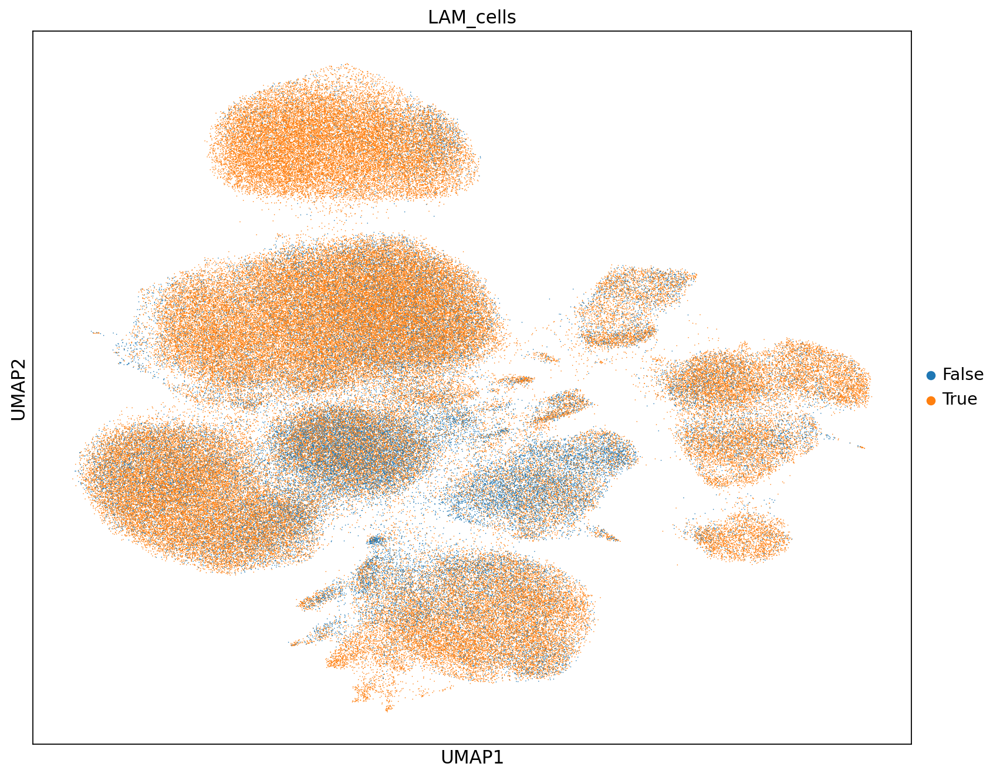

In [124]:
# plotting first by LAM cells before labelling the clusters manually 
# here is a trick to randomize the indices so there is no overplotting

np.random.seed(1)
random_indices = np.random.permutation(list(range(adata.shape[0])))

sc.pl.umap(adata[random_indices,:], color= ['LAM_cells'], vmin = .5, size= 2)

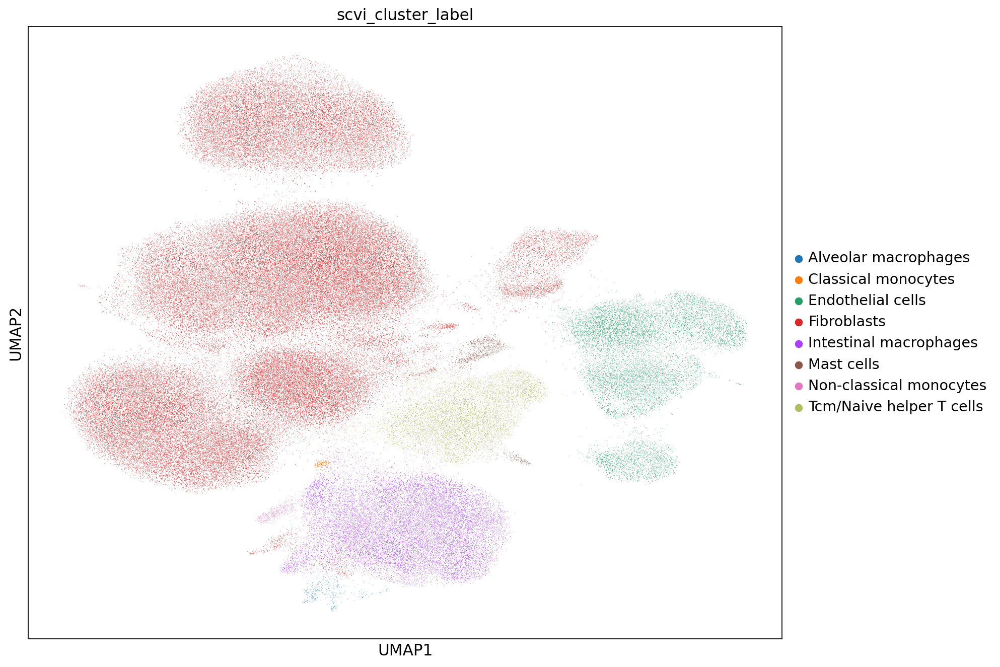

In [130]:
sc.pl.umap(adata, color= 'scvi_cluster_label')

In [128]:
print(adata.obs['scvi_leiden'].nunique())

32


In [129]:
print(adata.obs['scvi_cluster_label'].unique())

['Intestinal macrophages', 'Fibroblasts', 'Tcm/Naive helper T cells', 'Classical monocytes', 'Endothelial cells', 'Non-classical monocytes', 'Mast cells', 'Alveolar macrophages']
Categories (8, object): ['Alveolar macrophages', 'Classical monocytes', 'Endothelial cells', 'Fibroblasts', 'Intestinal macrophages', 'Mast cells', 'Non-classical monocytes', 'Tcm/Naive helper T cells']


In [131]:
sc.tl.louvain(adata, resolution=1.0, key_added='scvi_louvain')


In [132]:
adata

AnnData object with n_obs × n_vars = 191378 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels', 'leiden', 'scvi_leiden', 'scvi_cluster_label', 'scvi_louvain'
    var: 'n_cells'
    uns: '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'leiden', 'umap', 'pca', 'log1p', 'leiden_colors', 'Sample_colors', 'low_label_colors', 'low_major_colors', 'scvi_leiden', 'scvi_leiden_colors', 'scvi_cluster_label_colors', 'scvi_louvain'
    obsm: '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs', 'X_scVI', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

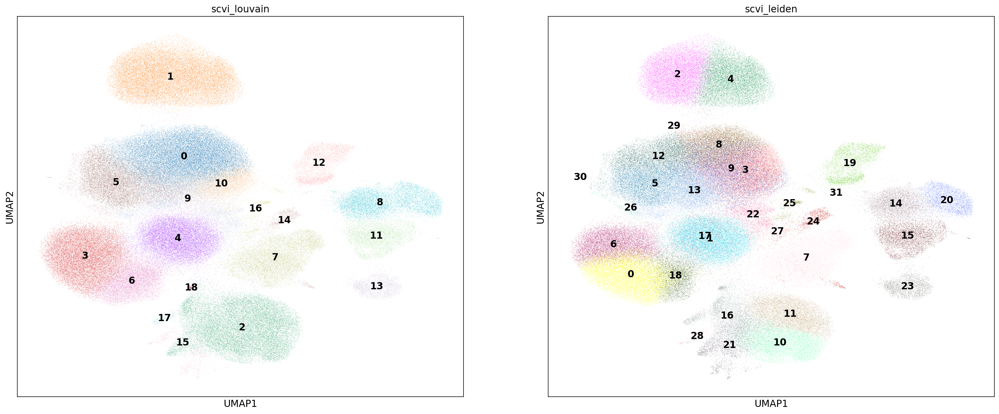

In [145]:
sc.pl.umap(adata, color= ['scvi_louvain', 'scvi_leiden'], legend_loc= 'on data')

### Rank Genes by Group

The function call `sc.tl.rank_genes_groups(adata, 'scvi_leiden')` identifies and ranks genes that are differentially expressed across the clusters defined by the `'scvi_leiden'` labels in the AnnData object (`adata`). This is an essential step in single-cell RNA sequencing analysis to understand the gene expression characteristics of different cell populations.

- **Input**:
  - **`adata`**: The AnnData object containing single-cell gene expression data and the cluster assignments.
  - **`'scvi_leiden'`**: This parameter specifies the grouping variable, which indicates the clusters to analyze. It uses the labels generated from a previous clustering step, in this case, the Leiden clustering identified in the `scvi_leiden` column of the `obs` attribute.

- **Functionality**:
  - The method computes statistical tests (e.g., t-tests or Wilcoxon rank-sum tests) to identify genes that are significantly differentially expressed between the groups (clusters).
  - It provides insights into which genes are upregulated or downregulated in specific clusters compared to others.

- **Output**:
  - The results are stored in the `adata.uns` attribute, specifically under `adata.uns['rank_genes_groups']`, where various statistics related to the differential expression analysis are accessible.
  - The output includes the ranked list of genes for each cluster, as well as additional information such as p-values, log-fold changes, and adjusted p-values.

By ranking genes across clusters, researchers can gain valuable insights into the biological functions and characteristics of the different cell populations identified in the dataset, facilitating further exploration and interpretation of the underlying biological processes.

In [146]:
sc.tl.rank_genes_groups(adata, 'scvi_leiden')
# this is going to update a new layer in the adata object that we can plot as marker genes according to the groups

/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_g

In [147]:
sc.pl.rank_genes_groups(adata, n_genes = 20, sharey= False)
# this function used to visualize the results of differential gene expression analysis we did in the previous cell and showing the top 20 for each cluster
# sharey=False, each subplot will have its own y-axis scale, which can be useful if the magnitude of differential expression varies greatly between groups.

### Differential Expression Analysis Using SCVI

The line `markers_scvi = model.differential_expression(groupby='scvi_leiden')` performs a differential expression analysis using a trained SCVI (Single-cell Variational Inference) model on the AnnData object (`adata`). This analysis aims to identify genes that are differentially expressed between the cell groups defined by the `'scvi_leiden'` labels.

- **Input**:
  - **`model`**: This refers to the previously trained SCVI model that captures the underlying distribution of the single-cell RNA sequencing data.
  - **`groupby='scvi_leiden'`**: This parameter specifies the categorical variable for grouping the cells. Here, it uses the cluster assignments obtained from the Leiden clustering stored in the `scvi_leiden` column of the `obs` attribute.

- **Functionality**:
  - The `differential_expression` method calculates the log-fold changes, p-values, and other statistics for each gene across the defined groups (clusters).
  - It leverages the statistical framework of the SCVI model to improve the robustness and accuracy of the differential expression results, accounting for the variability and noise commonly present in single-cell data.

- **Output**:
  - The results of the differential expression analysis are stored in the variable `markers_scvi`.
  - This output typically contains information about which genes are significantly differentially expressed in each cluster, along with their respective statistical metrics, such as adjusted p-values and effect sizes.

By performing this differential expression analysis, researchers can identify key marker genes that characterize different cell populations, enabling deeper insights into the biological functions and roles of these cells within the context of the studied system.


In [151]:
markers_scvi = model.differential_expression(groupby= 'scvi_leiden')
markers_scvi

DE...: 100%|████████████████████████████████████| 32/32 [10:24<00:00, 19.51s/it]


,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
AC103876.1,0.9788,0.0212,3.832326,0.000655,0.000130,0.0,0.25,3.532397,3.833908,2.614314,...,0.590665,0.096133,0.610914,0.092937,6.059118,1.096884,True,0 vs Rest,0,Rest
LAMB4,0.9780,0.0220,3.794467,0.000143,0.000026,0.0,0.25,3.595428,3.915847,2.388807,...,0.140380,0.018721,0.210397,0.024015,1.450333,0.215256,True,0 vs Rest,0,Rest
NELL1,0.9768,0.0232,3.740129,0.000248,0.000042,0.0,0.25,3.392072,3.520651,1.832119,...,0.215346,0.032231,0.267033,0.041753,2.147642,0.387118,True,0 vs Rest,0,Rest
CCBE1,0.9764,0.0236,3.722625,0.001041,0.000174,0.0,0.25,3.375709,3.418962,2.002172,...,0.788619,0.125865,0.683436,0.133576,7.997522,1.451334,True,0 vs Rest,0,Rest
IQCA1,0.9748,0.0252,3.655388,0.000171,0.000036,0.0,0.25,2.967355,3.145787,1.595717,...,0.204892,0.027727,0.336003,0.038688,2.074352,0.322993,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C1orf27,0.3810,0.6190,-0.485306,0.000086,0.000084,0.0,0.25,0.050779,0.071097,0.311805,...,0.203524,0.082653,0.187500,0.150030,2.730148,0.933454,False,31 vs Rest,31,Rest
SETD2,0.3786,0.6214,-0.495495,0.000257,0.000280,0.0,0.25,-0.104561,-0.113900,0.272440,...,0.727508,0.270161,0.687500,0.375472,8.893380,3.077211,False,31 vs Rest,31,Rest
METTL14,0.3758,0.6242,-0.507414,0.000053,0.000051,0.0,0.25,0.111741,0.119844,0.319712,...,0.394539,0.053422,0.437500,0.100386,4.976214,0.607394,False,31 vs Rest,31,Rest
NCOR1,0.3528,0.6472,-0.606754,0.000316,0.000343,0.0,0.25,-0.094608,-0.091667,0.284859,...,0.336666,0.337110,0.375000,0.441457,3.824495,3.869113,False,31 vs Rest,31,Rest


### Extract and Filter Differentially Expressed Genes

Following `markers = sc.get.rank_genes_groups_df(adata, None)` retrieves the results of the differential expression analysis stored in the AnnData object (`adata`). This results in a DataFrame that contains various statistics for each gene, including log-fold changes and adjusted p-values across the different groups defined in the analysis.

Subsequently, the expression `markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)]` filters this DataFrame to identify genes that are significantly differentially expressed. Specifically, it selects genes with an adjusted p-value below 0.05, indicating statistical significance, and a log-fold change greater than 0.5, suggesting a biologically relevant increase in expression. 

The filtered output provides a focused list of marker genes that are upregulated in the defined cell groups, facilitating further biological interpretation and downstream analyses, such as functional enrichment or validation studies.

In [149]:
# now we should get scanpy get.rank_genes_groups_df to get a df where the group assigned to cluster
# we'll save it markers and filter out p vals ajusted < 0.05 and keep only the ones with logfoldchanges > .5

markers = sc.get.rank_genes_groups_df(adata, None)
markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)]

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,ZFPM2,239.222321,2.368976,0.000000,0.000000
1,0,BNC2,230.432709,2.421764,0.000000,0.000000
2,0,PRKG1,223.948151,2.591243,0.000000,0.000000
3,0,AP000561.1,201.540848,3.438692,0.000000,0.000000
4,0,PLCB1,181.586136,2.536078,0.000000,0.000000
...,...,...,...,...,...,...
324318,31,PLAC9,2.248316,1.845517,0.040016,0.049267
324319,31,PHLDB1,2.247086,1.825612,0.040111,0.049372
324320,31,STARD8,2.245617,3.893296,0.040225,0.049506
324321,31,ITSN1,2.242967,1.068902,0.040428,0.049738


In [185]:
markers = markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)]
markers

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,ZFPM2,239.222321,2.368976,0.000000,0.000000
1,0,BNC2,230.432709,2.421764,0.000000,0.000000
2,0,PRKG1,223.948151,2.591243,0.000000,0.000000
3,0,AP000561.1,201.540848,3.438692,0.000000,0.000000
4,0,PLCB1,181.586136,2.536078,0.000000,0.000000
...,...,...,...,...,...,...
324318,31,PLAC9,2.248316,1.845517,0.040016,0.049267
324319,31,PHLDB1,2.247086,1.825612,0.040111,0.049372
324320,31,STARD8,2.245617,3.893296,0.040225,0.049506
324321,31,ITSN1,2.242967,1.068902,0.040428,0.049738


In [152]:
# we are going to only keep the true is_de_fdr_0.05 of this column and filter lfc_mean also

markers_scvi1 = markers_scvi[(markers_scvi['is_de_fdr_0.05']) & (markers_scvi.lfc_mean > 0.5)]

In [153]:
markers_scvi1

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,...,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2
AC103876.1,0.9788,0.0212,3.832326,0.000655,0.000130,0.0,0.25,3.532397,3.833908,2.614314,...,0.590665,0.096133,0.610914,0.092937,6.059118,1.096884,True,0 vs Rest,0,Rest
LAMB4,0.9780,0.0220,3.794467,0.000143,0.000026,0.0,0.25,3.595428,3.915847,2.388807,...,0.140380,0.018721,0.210397,0.024015,1.450333,0.215256,True,0 vs Rest,0,Rest
NELL1,0.9768,0.0232,3.740129,0.000248,0.000042,0.0,0.25,3.392072,3.520651,1.832119,...,0.215346,0.032231,0.267033,0.041753,2.147642,0.387118,True,0 vs Rest,0,Rest
CCBE1,0.9764,0.0236,3.722625,0.001041,0.000174,0.0,0.25,3.375709,3.418962,2.002172,...,0.788619,0.125865,0.683436,0.133576,7.997522,1.451334,True,0 vs Rest,0,Rest
IQCA1,0.9748,0.0252,3.655388,0.000171,0.000036,0.0,0.25,2.967355,3.145787,1.595717,...,0.204892,0.027727,0.336003,0.038688,2.074352,0.322993,True,0 vs Rest,0,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACNA1C,0.8884,0.1116,2.074501,0.000156,0.000157,0.0,0.25,0.723871,0.814240,1.400501,...,0.376974,0.126113,0.312500,0.153991,5.269044,1.429139,True,31 vs Rest,31,Rest
PMEPA1,0.8882,0.1118,2.072485,0.000054,0.000053,0.0,0.25,0.542813,0.676906,1.157164,...,0.000000,0.049451,0.000000,0.090546,0.000000,0.559603,True,31 vs Rest,31,Rest
FARP1,0.8882,0.1118,2.072485,0.000182,0.000111,0.0,0.25,0.979045,0.995862,0.890109,...,0.678845,0.116779,0.500000,0.173122,8.836926,1.319203,True,31 vs Rest,31,Rest
EIF3L,0.8880,0.1120,2.070473,0.000052,0.000031,0.0,0.25,0.835645,0.862234,0.520938,...,0.000000,0.033380,0.000000,0.062494,0.000000,0.387210,True,31 vs Rest,31,Rest


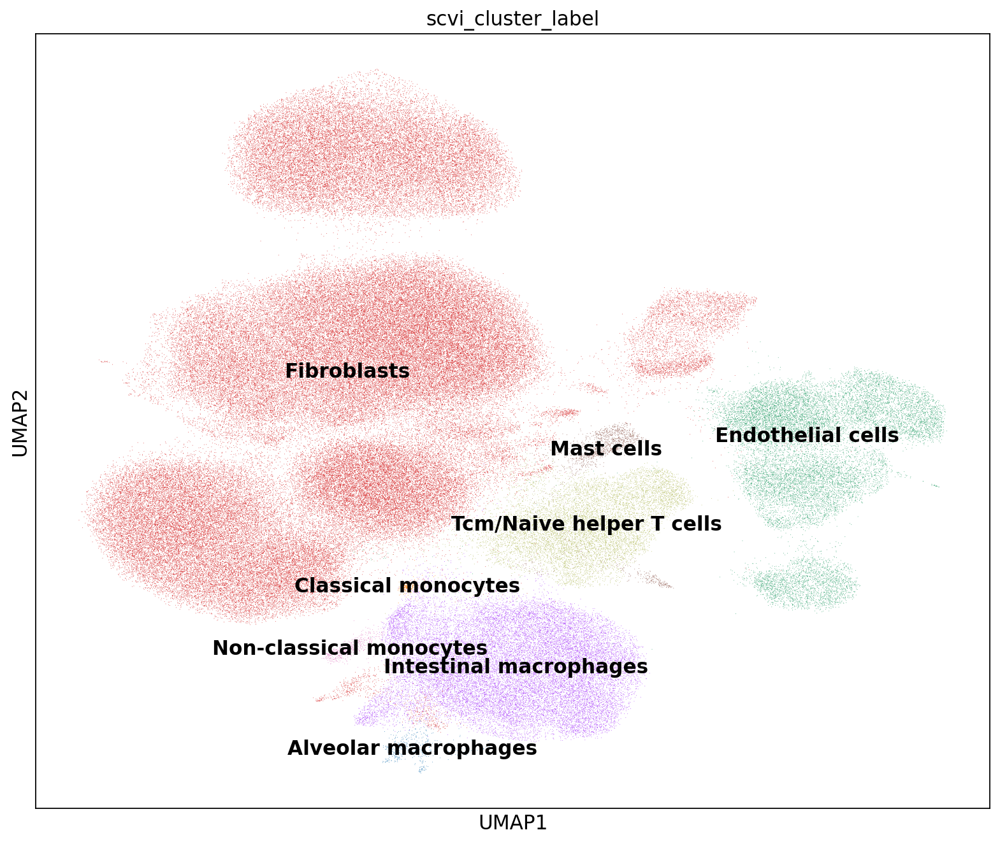

In [395]:
# not accurate of course as its only immune cells
sc.pl.umap(adata, color= ['scvi_cluster_label'], legend_loc= 'on data')

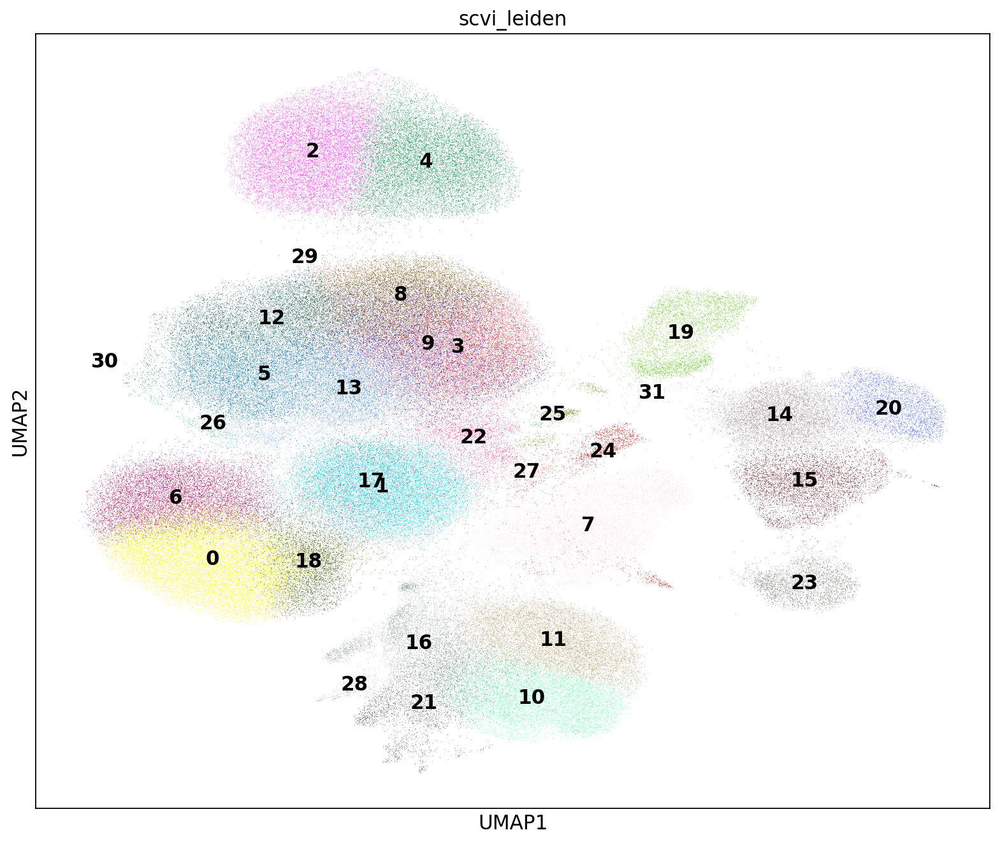

In [154]:
sc.pl.umap(adata, color= ['scvi_leiden'], legend_loc= 'on data')

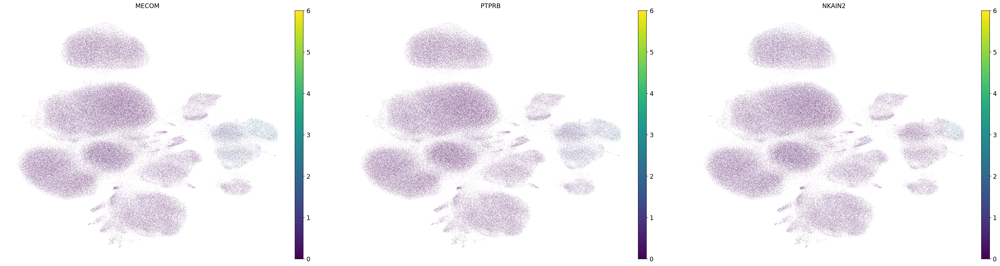

In [541]:
sc.pl.umap(adata, color= ['MECOM', 'PTPRB', 'NKAIN2'], frameon= False, vmax = 6)

In [523]:
markers[markers.names == 'ZFPM2']

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,ZFPM2,239.222321,2.368976,0.000000e+00,0.000000e+00
10455,1,ZFPM2,69.970642,1.139932,0.000000e+00,0.000000e+00
62667,6,ZFPM2,122.525536,1.609140,0.000000e+00,0.000000e+00
94125,9,ZFPM2,28.548523,0.591106,6.560445e-172,1.409821e-170
177566,17,ZFPM2,24.146042,0.692568,6.694684e-122,1.271260e-119
187993,18,ZFPM2,75.173325,1.701963,0.000000e+00,0.000000e+00
229772,22,ZFPM2,28.601826,1.278509,1.293611e-156,5.629363e-154
240302,23,ZFPM2,28.767221,0.904252,5.227725e-158,1.869807e-156
282104,27,ZFPM2,6.150617,1.024014,2.906447e-09,9.785600e-09


In [580]:
markers[markers.group == '31'].sort_values(by='logfoldchanges', ascending=False)

,group,names,scores,logfoldchanges,pvals,pvals_adj
323840,31,STOML2,4.844931,6.637626,2.141822e-04,2.848127e-04
323768,31,CNTNAP2,16.356117,6.507525,5.682941e-11,7.708134e-11
323982,31,SUMO4,3.318509,6.458188,4.677929e-03,6.068351e-03
323950,31,GPR156,3.483996,6.296906,3.331134e-03,4.342824e-03
324078,31,HIC2,2.932815,6.031799,1.028631e-02,1.314453e-02
...,...,...,...,...,...,...
324236,31,LRBA,2.442379,1.255571,2.744735e-02,3.420357e-02
324230,31,ROCK1,2.463138,1.203724,2.634997e-02,3.286352e-02
324321,31,ITSN1,2.242967,1.068902,4.042761e-02,4.973801e-02
324264,31,CALD1,2.370658,1.001276,3.157983e-02,3.919426e-02


### Cluster Labelling 

In [581]:
# starting labelling
# I'm more confident with the scvi_leiden resolution so we're gonna use it to label the clusters

cell_type = {
"0":"SVF_cells",
"1":"Macrophages",
"2":"Pre-adipocytes",
"3":"Stromal_cells",
"4":"Adipocytes",
"5":"Stromal_cells",
"6":"Epithelial_cells",
"7":"T_cells",
"8":"Macrophages",
"9":"Endothelial_cells",
"10":"Monocytes",
"11":"Macrophages",
"12":"Fibroblasts",
"13":"Macrophages",
"14":"Pre-adipocytes",
"15":"Endothelial_cells",
"16":"Macrophages",
"17":"Adipocytes",
"18":"Stromal_cells",
"19":"SMC",
"20":"Adipocyte_progenitor_cells",
"21":"Dendritic_cells",
"22":"Adipocytes",
"23":"Neuronal_cells",
"24":"Mast_cells",
"25":"NK_cells",
"26":"Lymphocytes",
"27":"B_cells",
"28":"Dendritic_cells",
"29":"Fibroblasts",
"30":"Fibroblasts",
"31":"Neuronal_cells"
}

In [582]:
adata.obs['cell_type'] = adata.obs.leiden.map(cell_type)

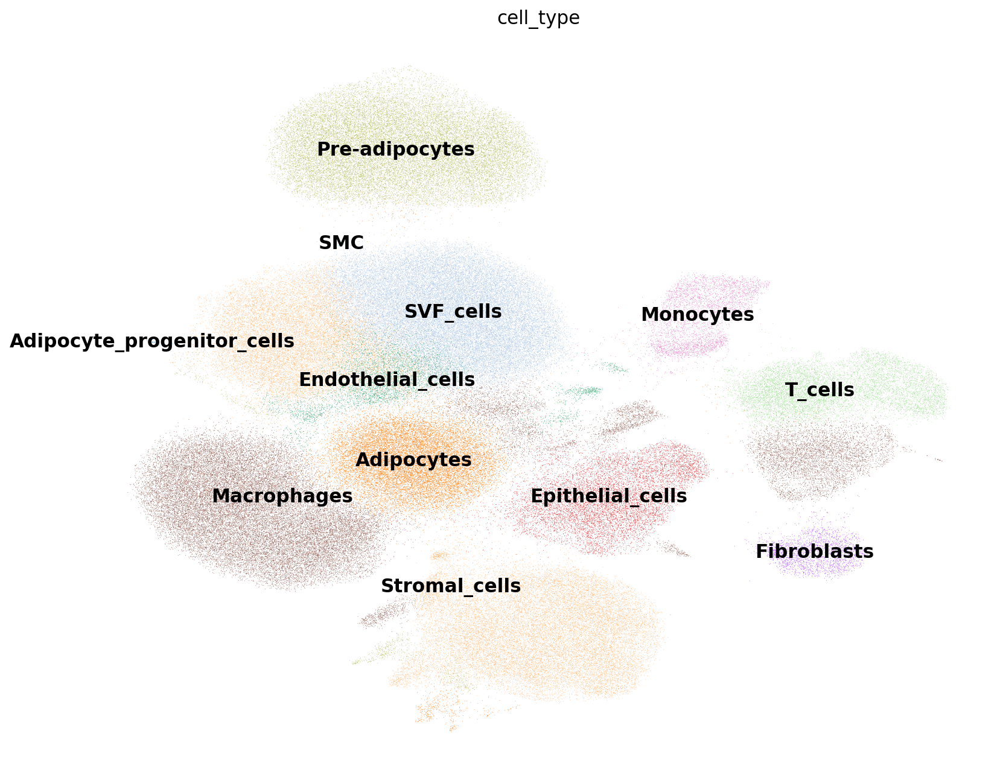

In [583]:
sc.pl.umap(adata, color= ['cell_type'], frameon= False, legend_loc='on data')

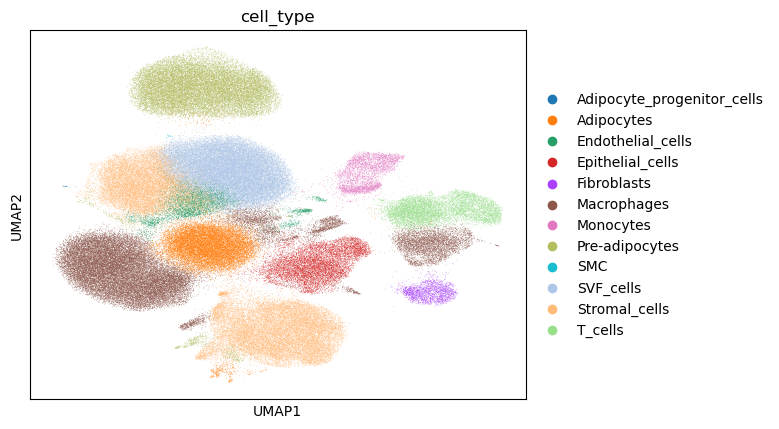

In [86]:
sc.pl.umap(adata, color= ['cell_type'], save= True, frameon= True)

In [586]:
# saving final markers in the unstructured layer
adata.uns['scvi_markers'] = markers_scvi1
adata.uns['markers'] = markers

In [587]:
adata.write_h5ad('temp3.h5ad')

In [393]:
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,...,doublet_score,low_label,low_score,_scvi_batch,_scvi_labels,leiden,scvi_leiden,scvi_cluster_label,scvi_louvain,_scvi_raw_norm_scaling
index,,,,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,...,0.430620,DC,0.134170,0,0,3,16,Intestinal macrophages,2,12.951592
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,...,0.012130,Double-positive thymocytes,0.937875,0,0,11,27,Fibroblasts,16,20.374281
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,...,0.083268,Fibroblasts,1.000000,0,0,5,12,Fibroblasts,0,13.004663
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,...,0.000017,Fibroblasts,0.862300,0,0,11,22,Fibroblasts,9,24.420803
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,...,0.043913,Fibroblasts,0.999521,0,0,5,12,Fibroblasts,0,16.524500
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,...,1.491288,Epithelial cells,0.999039,0,0,10,19,Fibroblasts,12,10.062852
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,...,0.003380,Endothelial cells,0.997817,0,0,7,20,Endothelial cells,8,11.937687
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,...,0.001058,Endothelial cells,1.000000,0,0,7,20,Endothelial cells,8,10.433825


---

## Analysis

In [603]:
sample_names = adata.obs.Sample.unique().tolist()

#### Integrating metadata

In [589]:
import yaml

metadata_dir = 'metadata'

metadata_list = []

# traverse through each subfolder in the metadata directory
for sample_folder in os.listdir(metadata_dir):
    sample_path = os.path.join(metadata_dir, sample_folder)
    
    # Check if the path is a directory
    if os.path.isdir(sample_path):
        yaml_file_path = os.path.join(sample_path, 'metadata.yaml')
        
        # Check if the metadata.yaml file exists
        if os.path.isfile(yaml_file_path):
            with open(yaml_file_path, 'r') as file:
                metadata = yaml.safe_load(file)  # load the YAML data
            
            # Add the sample name as a new key in the dictionary
            metadata['sample_id'] = sample_folder
            
            # Append the metadata dictionary to the list
            metadata_list.append(metadata)

# Convert the list of dictionaries to a DataFrame
metadata_df = pd.DataFrame(metadata_list)
metadata_df.head()

,name,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,organism_age,disease,bmi,sample_id,mouse_strain,organism_weight,diet
0,Hs_SAT_SVF_249-2A-1,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,"{'.': 'EFO:0008722', 'ontology_label': 'Drop-s...",EPI249,"{'.': 'NCBITaxon:9606', 'ontology_label': 'Hom...","{'.': 'UBERON:0001013', 'ontology_label': 'adi...","{'.': 'UBERON:0001347', 'ontology_label': 'whi...","{'.': 'UBERON:0002190', 'ontology_label': 'sub...","{'.': 'PATO:0000383', 'ontology_label': 'female'}","{'.': 'NCIT:C41261', 'ontology_label': 'White'}","{'.': 'HANCESTRO:0005', 'ontology_label': 'Eur...","{'.': 'HsapDv:0000148', 'ontology_label': '54-...","{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...","{'.': ['MONDO:0004992'], 'ontology_label': ['c...","{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-2A-1,NaN,NaN,NaN
1,Hs_SAT_SVF_236-2A-2,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,"{'.': 'EFO:0008722', 'ontology_label': 'Drop-s...",EPI236,"{'.': 'NCBITaxon:9606', 'ontology_label': 'Hom...","{'.': 'UBERON:0001013', 'ontology_label': 'adi...","{'.': 'UBERON:0001347', 'ontology_label': 'whi...","{'.': 'UBERON:0002190', 'ontology_label': 'sub...","{'.': 'PATO:0000383', 'ontology_label': 'female'}","{'.': 'NCIT:C41261', 'ontology_label': 'White'}","{'.': 'HANCESTRO:0005', 'ontology_label': 'Eur...","{'.': 'HsapDv:0000129', 'ontology_label': '35-...","{'.': 35, 'group': '30-40', 'unit': {'.': 'UO:...","{'.': ['PATO:0000461'], 'ontology_label': ['no...","{'.': 25.74, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_236-2A-2,NaN,NaN,NaN
2,Mm_ING_16-1,Mm_ING_16-1,PrimaryBioSample_Tissue,"{'.': 'EFO:0009922', 'ontology_label': '10x 3'...",HFD06.F,"{'.': 'NCBITaxon:10090', 'ontology_label': 'Mu...","{'.': 'UBERON:0001013', 'ontology_label': 'adi...","{'.': 'UBERON:0001347', 'ontology_label': 'whi...","{'.': 'UBERON:0010410', 'ontology_label': 'ing...","{'.': 'PATO:0000383', 'ontology_label': 'female'}",NaN,NaN,"{'.': 'MmusDv:0000070', 'ontology_label': '20 ...","{'.': 20, 'unit': {'.': 'UO:0000034', 'ontolog...","{'.': ['PATO:0000461'], 'ontology_label': ['no...",NaN,Mm_ING_16-1,"{'.': 'NCIT:C14424', 'ontology_label': 'C57BL/...","{'.': 30.23, 'unit': {'.': 'UO:0000021', 'onto...","{'type': 'high fat diet', 'schedule': 'ad libi..."
3,Mm_EPI_11-1,Mm_EPI_11-1,PrimaryBioSample_Tissue,"{'.': 'EFO:0009922', 'ontology_label': '10x 3'...",NCD06,"{'.': 'NCBITaxon:10090', 'ontology_label': 'Mu...","{'.': 'UBERON:0001013', 'ontology_label': 'adi...","{'.': 'UBERON:0001347', 'ontology_label': 'whi...","{'.': 'UBERON:0010412', 'ontology_label': 'epi...","{'.': 'PATO:0000384', 'ontology_label': 'male'}",NaN,NaN,"{'.': 'MmusDv:0000070', 'ontology_label': '20 ...","{'.': 20, 'unit': {'.': 'UO:0000034', 'ontolog...","{'.': ['PATO:0000461'], 'ontology_label': ['no...",NaN,Mm_EPI_11-1,"{'.': 'NCIT:C14424', 'ontology_label': 'C57BL/...","{'.': 33.99, 'unit': {'.': 'UO:0000021', 'onto...","{'type': 'normal chow diet', 'schedule': 'ad l..."
4,Hs_SAT_SVF_249-1A-1,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,"{'.': 'EFO:0008722', 'ontology_label': 'Drop-s...",EPI249,"{'.': 'NCBITaxon:9606', 'ontology_label': 'Hom...","{'.': 'UBERON:0001013', 'ontology_label': 'adi...","{'.': 'UBERON:0001347', 'ontology_label': 'whi...","{'.': 'UBERON:0002190', 'ontology_label': 'sub...","{'.': 'PATO:0000383', 'ontology_label': 'female'}","{'.': 'NCIT:C41261', 'ontology_label': 'White'}","{'.': 'HANCESTRO:0005', 'ontology_label': 'Eur...","{'.': 'HsapDv:0000148', 'ontology_label': '54-...","{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...","{'.': ['MONDO:0004992'], 'ontology_label': ['c...","{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-1A-1,NaN,NaN,NaN


In [598]:
columns_to_clean = ['species', 'library_preparation_protocol', 'organ', 'tissue', 'depot', 'sex', 'race', 'ethnicity', 'development_stage', 'disease', 'mouse_strain']

for column in columns_to_clean:
    metadata_df[column] = metadata_df[column].apply(lambda x: x['ontology_label'] if isinstance(x, dict) and 'ontology_label' in x else x)

In [600]:
metadata_df.head()

,name,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,organism_age,disease,bmi,sample_id,mouse_strain,organism_weight,diet
0,Hs_SAT_SVF_249-2A-1,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-2A-1,NaN,NaN,NaN
1,Hs_SAT_SVF_236-2A-2,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,"{'.': 35, 'group': '30-40', 'unit': {'.': 'UO:...",[normal],"{'.': 25.74, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_236-2A-2,NaN,NaN,NaN
2,Mm_ING_16-1,Mm_ING_16-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,HFD06.F,Mus musculus,adipose tissue,white adipose tissue,inguinal fat pad,female,NaN,NaN,20 weeks,"{'.': 20, 'unit': {'.': 'UO:0000034', 'ontolog...",[normal],NaN,Mm_ING_16-1,C57BL/6 Mouse,"{'.': 30.23, 'unit': {'.': 'UO:0000021', 'onto...","{'type': 'high fat diet', 'schedule': 'ad libi..."
3,Mm_EPI_11-1,Mm_EPI_11-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,NCD06,Mus musculus,adipose tissue,white adipose tissue,epididymal fat pad,male,NaN,NaN,20 weeks,"{'.': 20, 'unit': {'.': 'UO:0000034', 'ontolog...",[normal],NaN,Mm_EPI_11-1,C57BL/6 Mouse,"{'.': 33.99, 'unit': {'.': 'UO:0000021', 'onto...","{'type': 'normal chow diet', 'schedule': 'ad l..."
4,Hs_SAT_SVF_249-1A-1,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-1A-1,NaN,NaN,NaN


In [601]:
metadata_df_Hs = metadata_df[~metadata_df['biosample_id'].str.contains('Mm')]
metadata_df_Hs.head()

,name,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,organism_age,disease,bmi,sample_id,mouse_strain,organism_weight,diet
0,Hs_SAT_SVF_249-2A-1,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-2A-1,NaN,NaN,NaN
1,Hs_SAT_SVF_236-2A-2,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,"{'.': 35, 'group': '30-40', 'unit': {'.': 'UO:...",[normal],"{'.': 25.74, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_236-2A-2,NaN,NaN,NaN
4,Hs_SAT_SVF_249-1A-1,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_249-1A-1,NaN,NaN,NaN
7,Hs_SAT_SVF_237-1A-1,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,"{'.': 53, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 22.59, 'group': '20-30', 'unit': {'.': '...",Hs_SAT_SVF_237-1A-1,NaN,NaN,NaN
8,Hs_OAT_13-1,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,"{'.': 24, 'group': '20-30', 'unit': {'.': 'UO:...",[normal],"{'.': 43.2, 'group': '40-50', 'unit': {'.': 'U...",Hs_OAT_13-1,NaN,NaN,NaN


In [602]:
metadata_df_Hs.shape

(60, 20)

In [604]:
len(sample_names)

60

In [608]:
metadata_df_Hs.drop('mouse_strain', axis= 1, inplace=True)
metadata_df_Hs.shape

/tmp/ipykernel_309788/3663787530.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs.drop('mouse_strain', axis= 1, inplace=True)


(60, 19)

In [611]:
metadata_df_Hs.head()

,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,organism_age,disease,bmi,organism_weight,diet
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",NaN,NaN
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,"{'.': 35, 'group': '30-40', 'unit': {'.': 'UO:...",[normal],"{'.': 25.74, 'group': '20-30', 'unit': {'.': '...",NaN,NaN
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 26.46, 'group': '20-30', 'unit': {'.': '...",NaN,NaN
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,"{'.': 53, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],"{'.': 22.59, 'group': '20-30', 'unit': {'.': '...",NaN,NaN
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,"{'.': 24, 'group': '20-30', 'unit': {'.': 'UO:...",[normal],"{'.': 43.2, 'group': '40-50', 'unit': {'.': 'U...",NaN,NaN


In [610]:
metadata_df_Hs.drop(['sample_id', 'name'], axis= 1, inplace=True)


/tmp/ipykernel_309788/3088239787.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs.drop(['sample_id', 'name'], axis= 1, inplace=True)


In [612]:
metadata_df_Hs['bmi'][0]

{'.': 26.46,
 'group': '20-30',
 'unit': {'.': 'UO:0000086', 'ontology_label': 'kilogram per square meter'}}

In [613]:
# extracting the numerical BMI values into a new column
metadata_df_Hs['bmi_value'] = metadata_df_Hs['bmi'].apply(lambda x: x['.'] if isinstance(x, dict) and '.' in x else None)
metadata_df_Hs['bmi_group'] = metadata_df_Hs['bmi'].apply(lambda x: x['group'] if isinstance(x, dict) and 'group' in x else None)
metadata_df_Hs.drop('bmi', axis=1, inplace=True)

metadata_df_Hs.head()

/tmp/ipykernel_309788/219125986.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs['bmi_value'] = metadata_df_Hs['bmi'].apply(lambda x: x['.'] if isinstance(x, dict) and '.' in x else None)
/tmp/ipykernel_309788/219125986.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs['bmi_group'] = metadata_df_Hs['bmi'].apply(lambda x: x['group'] if isinstance(x, dict) and 'group' in x else None)
/tmp/ipykernel_309788/219125986.py:4: SettingWithCopyWarning: 
A value is trying to be set o

,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,organism_age,disease,organism_weight,diet,bmi_value,bmi_group
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],NaN,NaN,26.46,20-30
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,"{'.': 35, 'group': '30-40', 'unit': {'.': 'UO:...",[normal],NaN,NaN,25.74,20-30
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,"{'.': 54, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],NaN,NaN,26.46,20-30
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,"{'.': 53, 'group': '50-60', 'unit': {'.': 'UO:...",[cancer],NaN,NaN,22.59,20-30
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,"{'.': 24, 'group': '20-30', 'unit': {'.': 'UO:...",[normal],NaN,NaN,43.20,40-50


In [614]:
metadata_df_Hs['organism_age'][0]

{'.': 54,
 'group': '50-60',
 'unit': {'.': 'UO:0000036', 'ontology_label': 'year'}}

In [615]:
metadata_df_Hs['age'] = metadata_df_Hs['organism_age'].apply(lambda x: x['.'] if isinstance(x, dict) and '.' in x else None)
metadata_df_Hs.drop('organism_age', axis=1, inplace=True)

metadata_df_Hs.head()

/tmp/ipykernel_309788/2090983194.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs['age'] = metadata_df_Hs['organism_age'].apply(lambda x: x['.'] if isinstance(x, dict) and '.' in x else None)
/tmp/ipykernel_309788/2090983194.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs.drop('organism_age', axis=1, inplace=True)


,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,disease,organism_weight,diet,bmi_value,bmi_group,age
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,[cancer],NaN,NaN,26.46,20-30,54
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,[normal],NaN,NaN,25.74,20-30,35
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,[cancer],NaN,NaN,26.46,20-30,54
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,[cancer],NaN,NaN,22.59,20-30,53
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,[normal],NaN,NaN,43.20,40-50,24


In [618]:
metadata_df_Hs['disease'][0]

['cancer']

In [619]:
# Extract the disease name from the list
metadata_df_Hs['disease'] = metadata_df_Hs['disease'].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else None)
metadata_df_Hs.head()

/tmp/ipykernel_309788/3720877653.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs['disease'] = metadata_df_Hs['disease'].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else None)


,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,disease,organism_weight,diet,bmi_value,bmi_group,age
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,cancer,NaN,NaN,26.46,20-30,54
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,normal,NaN,NaN,25.74,20-30,35
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,cancer,NaN,NaN,26.46,20-30,54
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,cancer,NaN,NaN,22.59,20-30,53
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,normal,NaN,NaN,43.20,40-50,24


In [623]:
metadata_df_Hs.drop(['organism_weight', 'diet'], axis=1, inplace=True)

metadata_df_Hs.head()

/tmp/ipykernel_309788/2467883170.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs.drop(['organism_weight', 'diet'], axis=1, inplace=True)


,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,development_stage,disease,bmi_value,bmi_group,age
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,cancer,26.46,20-30,54
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,35-year-old human stage,normal,25.74,20-30,35
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,54-year-old human stage,cancer,26.46,20-30,54
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,53-year-old human stage,cancer,22.59,20-30,53
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,24-year-old human stage,normal,43.20,40-50,24


In [625]:
metadata_df_Hs.drop(['development_stage'], axis=1, inplace=True)
metadata_df_Hs.head()

/tmp/ipykernel_309788/19249696.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  metadata_df_Hs.drop(['development_stage'], axis=1, inplace=True)


,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,bmi_group,age
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,25.74,20-30,35
4,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
7,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,22.59,20-30,53
8,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,normal,43.20,40-50,24


In [626]:
metadata_df_Hs.shape

(60, 15)

In [629]:
metadata_df_Hs.to_csv('metadata_df_Hs.csv', index=False)

In [631]:
metadata_df_Hs.set_index('biosample_id', inplace=True)
metadata_df_Hs.head()

,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,bmi_group,age
biosample_id,,,,,,,,,,,,,,
Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,25.74,20-30,35
Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,22.59,20-30,53
Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,normal,43.20,40-50,24


In [3]:
adata = sc.read_h5ad('temp3.h5ad')
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,...,low_label,low_score,_scvi_batch,_scvi_labels,leiden,scvi_leiden,scvi_cluster_label,scvi_louvain,_scvi_raw_norm_scaling,cell_type
index,,,,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,...,DC,0.134170,0,0,3,16,Intestinal macrophages,2,12.951592,Stromal_cells
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,...,Double-positive thymocytes,0.937875,0,0,11,27,Fibroblasts,16,20.374281,Macrophages
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,...,Fibroblasts,1.000000,0,0,5,12,Fibroblasts,0,13.004663,Stromal_cells
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,...,Fibroblasts,0.862300,0,0,11,22,Fibroblasts,9,24.420803,Macrophages
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,...,Fibroblasts,0.999521,0,0,5,12,Fibroblasts,0,16.524500,Stromal_cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,...,Epithelial cells,0.999039,0,0,10,19,Fibroblasts,12,10.062852,Monocytes
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,...,Endothelial cells,0.997817,0,0,7,20,Endothelial cells,8,11.937687,T_cells
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,...,Endothelial cells,1.000000,0,0,7,20,Endothelial cells,8,10.433825,T_cells


In [4]:
metadata_df_Hs = pd.read_csv('metadata_df_Hs.csv')
metadata_df_Hs.head()

,biosample_id,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,bmi_group,age
0,Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
1,Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,25.74,20-30,35
2,Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
3,Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,22.59,20-30,53
4,Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,normal,43.20,40-50,24


In [5]:
metadata_df_Hs = metadata_df_Hs.set_index('biosample_id')
metadata_df_Hs.head()

,biosample_type,library_preparation_protocol,donor_id,species,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,bmi_group,age
biosample_id,,,,,,,,,,,,,,
Hs_SAT_SVF_249-2A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
Hs_SAT_SVF_236-2A-2,PrimaryBioSample_Tissue,Drop-seq,EPI236,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,25.74,20-30,35
Hs_SAT_SVF_249-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI249,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,26.46,20-30,54
Hs_SAT_SVF_237-1A-1,PrimaryBioSample_Tissue,Drop-seq,EPI237,Homo sapiens,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,cancer,22.59,20-30,53
Hs_OAT_13-1,PrimaryBioSample_Tissue,10x 3' v3 sequencing,UP1018-S,Homo sapiens,adipose tissue,white adipose tissue,omental fat pad,male,White,European,normal,43.20,40-50,24


In [7]:
sample_to_metadata = metadata_df_Hs.to_dict(orient='index')


In [8]:
def map_sample_to_metadata(sample, feature):
    return sample_to_metadata.get(sample, {}).get(feature, None)

# adding metadata columns to adata.obs
for column in metadata_df_Hs.columns:
    adata.obs[column] = adata.obs['Sample'].map(lambda x: map_sample_to_metadata(x, column))


In [12]:
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,...,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,bmi_group,age
index,,,,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,36.04,30-40,53
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,36.04,30-40,53
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,36.04,30-40,53
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,36.04,30-40,53
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,female,White,European,normal,36.04,30-40,53
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,male,White,European,normal,22.15,20-30,68
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,male,White,European,normal,22.15,20-30,68
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,...,adipose tissue,white adipose tissue,subcutaneous adipose tissue,male,White,European,normal,22.15,20-30,68


In [11]:
adata.write_h5ad('integrated.h5ad')

In [15]:
# for frequency we need to count the number of cells in each celltype and number of cells total in each sample

# counting total no. in each sample

num_total_cells = adata.obs.groupby(['Sample']).count()
num_total_cells = dict(zip(num_total_cells.index, num_total_cells.n_genes))
num_total_cells

{'Hs_OAT_01-1': 6299,
 'Hs_OAT_01-2': 4941,
 'Hs_OAT_09-1': 4316,
 'Hs_OAT_10-1': 6874,
 'Hs_OAT_12-1': 9592,
 'Hs_OAT_13-1': 8006,
 'Hs_OAT_253-1': 26657,
 'Hs_OAT_254-1': 11441,
 'Hs_OAT_255-1': 5822,
 'Hs_OAT_256-1': 6053,
 'Hs_OAT_266-1': 4919,
 'Hs_SAT_01-1': 4677,
 'Hs_SAT_02-1': 4708,
 'Hs_SAT_04-1': 1799,
 'Hs_SAT_09-1': 409,
 'Hs_SAT_10-1': 646,
 'Hs_SAT_11-1': 1693,
 'Hs_SAT_12-1': 4362,
 'Hs_SAT_13-1': 5550,
 'Hs_SAT_253-1': 2193,
 'Hs_SAT_254-1': 10184,
 'Hs_SAT_255-1': 4370,
 'Hs_SAT_256-1': 4549,
 'Hs_SAT_266-1': 4907,
 'Hs_SAT_SVF_235-1A-1': 1366,
 'Hs_SAT_SVF_235-1A-2': 434,
 'Hs_SAT_SVF_235-1B-1': 874,
 'Hs_SAT_SVF_235-1B-2': 815,
 'Hs_SAT_SVF_235-2A-1': 1542,
 'Hs_SAT_SVF_235-2A-2': 1988,
 'Hs_SAT_SVF_235-2B-1': 1747,
 'Hs_SAT_SVF_235-2B-2': 1622,
 'Hs_SAT_SVF_236-1A-1': 1645,
 'Hs_SAT_SVF_236-1A-2': 2880,
 'Hs_SAT_SVF_236-1B-1': 1873,
 'Hs_SAT_SVF_236-2A-2': 1675,
 'Hs_SAT_SVF_237-1A-1': 1167,
 'Hs_SAT_SVF_237-2A-1': 866,
 'Hs_SAT_SVF_238-1A-1': 2245,
 'Hs_SAT_SVF_23

In [19]:
cell_type_counts = adata.obs.groupby(['Sample', 'bmi_group', 'cell_type']).count()
cell_type_counts = cell_type_counts[cell_type_counts.sum(axis= 1) > 0].reset_index()
cell_type_counts

,Sample,bmi_group,cell_type,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,...,species,organ,tissue,depot,sex,race,ethnicity,disease,bmi_value,age
0,Hs_OAT_01-1,40-50,Adipocytes,41,41,41,41,41,41,41,...,41,41,41,41,41,41,41,41,41,41
1,Hs_OAT_01-1,40-50,Endothelial_cells,38,38,38,38,38,38,38,...,38,38,38,38,38,38,38,38,38,38
2,Hs_OAT_01-1,40-50,Epithelial_cells,431,431,431,431,431,431,431,...,431,431,431,431,431,431,431,431,431,431
3,Hs_OAT_01-1,40-50,Fibroblasts,210,210,210,210,210,210,210,...,210,210,210,210,210,210,210,210,210,210
4,Hs_OAT_01-1,40-50,Macrophages,2504,2504,2504,2504,2504,2504,2504,...,2504,2504,2504,2504,2504,2504,2504,2504,2504,2504
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
582,Hs_SAT_SVF_249-2B-1,20-30,Macrophages,6,6,6,6,6,6,6,...,6,6,6,6,6,6,6,6,6,6
583,Hs_SAT_SVF_249-2B-1,20-30,Monocytes,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
584,Hs_SAT_SVF_249-2B-1,20-30,SVF_cells,38,38,38,38,38,38,38,...,38,38,38,38,38,38,38,38,38,38
585,Hs_SAT_SVF_249-2B-1,20-30,Stromal_cells,66,66,66,66,66,66,66,...,66,66,66,66,66,66,66,66,66,66


In [20]:
cell_type_counts = cell_type_counts[cell_type_counts.columns[0:4]]
cell_type_counts

,Sample,bmi_group,cell_type,n_genes
0,Hs_OAT_01-1,40-50,Adipocytes,41
1,Hs_OAT_01-1,40-50,Endothelial_cells,38
2,Hs_OAT_01-1,40-50,Epithelial_cells,431
3,Hs_OAT_01-1,40-50,Fibroblasts,210
4,Hs_OAT_01-1,40-50,Macrophages,2504
...,...,...,...,...
582,Hs_SAT_SVF_249-2B-1,20-30,Macrophages,6
583,Hs_SAT_SVF_249-2B-1,20-30,Monocytes,1
584,Hs_SAT_SVF_249-2B-1,20-30,SVF_cells,38
585,Hs_SAT_SVF_249-2B-1,20-30,Stromal_cells,66


In [26]:
cell_type_counts['frequency'] = cell_type_counts.n_genes / cell_type_counts.total_counts

cell_type_counts['total_cells'] = cell_type_counts.Sample.map(num_total_cells).astype(int)

cell_type_counts = cell_type_counts.drop('total_counts', axis=1)

cell_type_counts

,Sample,bmi_group,cell_type,n_genes,frequency,total_cells
0,Hs_OAT_01-1,40-50,Adipocytes,41,0.006509,6299
1,Hs_OAT_01-1,40-50,Endothelial_cells,38,0.006033,6299
2,Hs_OAT_01-1,40-50,Epithelial_cells,431,0.068424,6299
3,Hs_OAT_01-1,40-50,Fibroblasts,210,0.033339,6299
4,Hs_OAT_01-1,40-50,Macrophages,2504,0.397523,6299
...,...,...,...,...,...,...
582,Hs_SAT_SVF_249-2B-1,20-30,Macrophages,6,0.031579,190
583,Hs_SAT_SVF_249-2B-1,20-30,Monocytes,1,0.005263,190
584,Hs_SAT_SVF_249-2B-1,20-30,SVF_cells,38,0.200000,190
585,Hs_SAT_SVF_249-2B-1,20-30,Stromal_cells,66,0.347368,190


In [27]:
cell_type_counts

,Sample,bmi_group,cell_type,n_genes,frequency,total_cells
0,Hs_OAT_01-1,40-50,Adipocytes,41,0.006509,6299
1,Hs_OAT_01-1,40-50,Endothelial_cells,38,0.006033,6299
2,Hs_OAT_01-1,40-50,Epithelial_cells,431,0.068424,6299
3,Hs_OAT_01-1,40-50,Fibroblasts,210,0.033339,6299
4,Hs_OAT_01-1,40-50,Macrophages,2504,0.397523,6299
...,...,...,...,...,...,...
582,Hs_SAT_SVF_249-2B-1,20-30,Macrophages,6,0.031579,190
583,Hs_SAT_SVF_249-2B-1,20-30,Monocytes,1,0.005263,190
584,Hs_SAT_SVF_249-2B-1,20-30,SVF_cells,38,0.200000,190
585,Hs_SAT_SVF_249-2B-1,20-30,Stromal_cells,66,0.347368,190


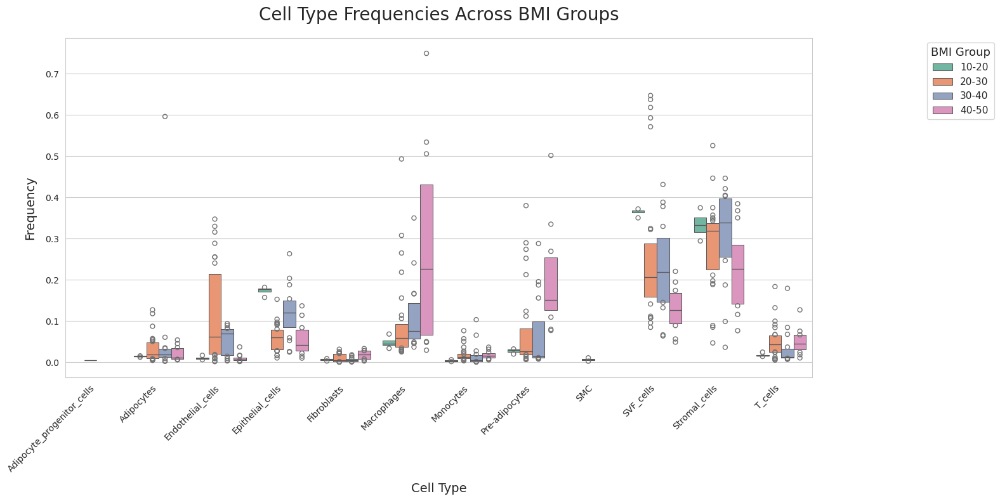

In [34]:
plt.figure(figsize=(16, 8))
sns.set_style("whitegrid")
sns.set_palette("Set2")

ax = sns.boxenplot(data=cell_type_counts, x='cell_type', y='frequency', hue='bmi_group')

plt.title('Cell Type Frequencies Across BMI Groups', fontsize=20, pad=20)
plt.xlabel('Cell Type', fontsize=14, labelpad=10)
plt.ylabel('Frequency', fontsize=14, labelpad=10)

plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)

plt.legend(title='BMI Group', title_fontsize='13', fontsize='11', loc='upper right', bbox_to_anchor=(1.25, 1))

plt.tight_layout()
plt.savefig('cell_type_frequencies.png', dpi=300, bbox_inches='tight')
plt.show()


In [37]:
adata.obs['LAM_cells']

index
AAAAATGACGCA         True
AAAAGGAAAGAA        False
AAAAGGCGACGT         True
AAAAGTTATGAT        False
AAAATCGGTCCA         True
                    ...  
TTTGTTGGTAATGCGG    False
TTTGTTGGTCGTGTTA     True
TTTGTTGGTTCTCTCG     True
TTTGTTGTCGGCTGAC     True
TTTGTTGTCGGTAGGA     True
Name: LAM_cells, Length: 191378, dtype: bool

## Differential Expression

In [46]:
macrophages = adata[adata.obs['cell_type'].isin(['Macrophages'])].copy()
macrophages

AnnData object with n_obs × n_vars = 40331 × 10444
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels', 'leiden', 'scvi_leiden', 'scvi_cluster_label', 'scvi_louvain', '_scvi_raw_norm_scaling', 'cell_type', 'biosample_type', 'library_preparation_protocol', 'donor_id', 'species', 'organ', 'tissue', 'depot', 'sex', 'race', 'ethnicity', 'disease', 'bmi_value', 'bmi_group', 'age'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'low_label_colors', 'low_major_colors', 'markers', 'neighbors', 'pca', 'rank_genes_groups', 'scvi_cluster_label_colors', 'scvi_leiden', 'scvi_leiden_colors', 'scvi_louvain', 'scvi_louvain_colors', 'scvi_markers', 'umap'
    obsm: 'X_pca', 'X

In [7]:
import diffxpy.api as de

In [50]:
len(macrophages.var)

10444

In [51]:
sc.pp.filter_genes(macrophages, min_cells=100)

In [52]:
macrophages

AnnData object with n_obs × n_vars = 40331 × 10436
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels', 'leiden', 'scvi_leiden', 'scvi_cluster_label', 'scvi_louvain', '_scvi_raw_norm_scaling', 'cell_type', 'biosample_type', 'library_preparation_protocol', 'donor_id', 'species', 'organ', 'tissue', 'depot', 'sex', 'race', 'ethnicity', 'disease', 'bmi_value', 'bmi_group', 'age'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'low_label_colors', 'low_major_colors', 'markers', 'neighbors', 'pca', 'rank_genes_groups', 'scvi_cluster_label_colors', 'scvi_leiden', 'scvi_leiden_colors', 'scvi_louvain', 'scvi_louvain_colors', 'scvi_markers', 'umap'
    obsm: 'X_pca', 'X

In [53]:
len(macrophages.var)

10436

In [60]:
macrophages.obs['bmi_group'] = macrophages.obs['bmi_group'].astype('category')

In [85]:
macrophages.obs['bmi_group'].value_counts()

bmi_group
40-50    20430
20-30    10554
30-40     9048
10-20      299
Name: count, dtype: int64

In [74]:
# Remove observations with any NaN values in the obs DataFrame
macrophages = macrophages[~macrophages.obs.isna().any(axis=1)]
macrophages = macrophages[:, ~macrophages.var.isna().any(axis=1)]
macrophages.X = np.nan_to_num(macrophages.X, nan=0)

In [4]:
# Merge '10-20' with '20-30'
#macrophages.obs['bmi_group_merged'] = macrophages.obs['bmi_group'].replace({'10-20': '20-30'})

#macrophages.obs['bmi_group_merged'].value_counts()
macrophages_excl = macrophages[macrophages.obs['bmi_group'] != '10-20']


In [3]:
macrophages = sc.read_h5ad('macrophages_temp.h5ad')
macrophages

AnnData object with n_obs × n_vars = 40331 × 10436
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels', 'leiden', 'scvi_leiden', 'scvi_cluster_label', 'scvi_louvain', '_scvi_raw_norm_scaling', 'cell_type', 'biosample_type', 'library_preparation_protocol', 'donor_id', 'species', 'organ', 'tissue', 'depot', 'sex', 'race', 'ethnicity', 'disease', 'bmi_value', 'bmi_group', 'age'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'low_label_colors', 'low_major_colors', 'markers', 'neighbors', 'pca', 'rank_genes_groups', 'scvi_cluster_label_colors', 'scvi_leiden', 'scvi_leiden_colors', 'scvi_louvain', 'scvi_louvain_colors', 'scvi_markers', 'umap'
    obsm: 'X_pca', 'X

In [5]:
import dask
dask.__version__

'2021.04.0'

In [12]:
res = de.test.wald(
    data=macrophages,
    formula_loc='~ bmi_group',
    factor_loc_totest='bmi_group'
) 

/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/batchglm/models/base_glm/utils.py:110: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': True}):
    ...     array[indexer]
  np.mean(x[np.where(grouping == g)[0], :], axis=0)
/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/batchglm/models/base_glm/utils.py:110: PerformanceWarning: Slicing is producing a large chunk. To accept the large
chunk and silence this warning, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    ...     array[indexer]

To avoid creating the large chunks, set the option
    >>> with dask.config.set(**{'array.slicing.split_large_chunks':

training location model: False
training scale model: True
iter   0: ll=10261706185.857611
iter   1: ll=10261706185.857611, converged: 0.00% (loc: 100.00%, scale update: False), in 0.00sec
iter   2: ll=89246047.682697, converged: 0.00% (loc: 0.00%, scale update: True), in 324.82sec
iter   3: ll=89246047.682697, converged: 0.00% (loc: 100.00%, scale update: False), in 0.00sec
iter   4: ll=53670262.395558, converged: 27.08% (loc: 27.08%, scale update: True), in 282.13sec
iter   5: ll=53670262.395558, converged: 27.08% (loc: 100.00%, scale update: False), in 0.00sec
iter   6: ll=45893780.684846, converged: 69.93% (loc: 69.93%, scale update: True), in 221.73sec
iter   7: ll=45893780.684846, converged: 69.93% (loc: 100.00%, scale update: False), in 0.00sec
iter   8: ll=44099611.668763, converged: 91.59% (loc: 91.59%, scale update: True), in 135.36sec
iter   9: ll=44099611.668763, converged: 91.59% (loc: 100.00%, scale update: False), in 0.00sec
iter  10: ll=43681367.529947, converged: 98.10%

In [16]:
dedf_excl = res_excl.summary().sort_values('log2fc', ascending= False).reset_index(drop= True)
dedf_excl

,gene,pval,qval,log2fc,mean,zero_mean,grad,ll
0,LRRC4C,0.0,0.0,2.527396,0.129953,False,6.097643e-12,-14922.287609
1,CLSTN2,0.0,0.0,2.187470,0.051068,False,1.865167e-02,-1677.618152
2,LINC01163,0.0,0.0,2.069335,0.006456,False,9.950908e-10,-1088.760700
3,AC093772.1,0.0,0.0,1.913933,0.007919,False,9.187580e-03,-148.755831
4,AL590867.1,0.0,0.0,1.780466,0.004153,False,3.828267e-03,-667.163707
...,...,...,...,...,...,...,...,...
10431,SERPINE1,0.0,0.0,-2.898973,0.027737,False,4.064171e-09,-4191.081301
10432,FOS,0.0,0.0,-3.012637,0.140065,False,7.814023e-10,-14324.300251
10433,CXCL2,0.0,0.0,-3.024313,0.019806,False,8.887863e-10,-3274.141272
10434,MT1X,0.0,0.0,-3.197906,0.039490,False,2.377337e-11,-5695.503121


In [15]:
dedf =res.summary().sort_values('log2fc', ascending= False).reset_index(drop= True)
dedf

,gene,pval,qval,log2fc,mean,zero_mean,grad,ll
0,ZNF519,NaN,NaN,283.913085,0.063662,False,1.273220e-01,-35187.091934
1,KCNK15-AS1,NaN,NaN,283.913085,0.024319,False,4.863523e-02,-13431.107743
2,AC007099.1,NaN,NaN,283.913085,0.007494,False,1.498804e-02,-4149.311585
3,AL117190.1,NaN,NaN,283.913085,0.011322,False,2.264646e-02,-6235.298197
4,DACT1,NaN,NaN,283.913085,0.002521,False,6.206239e-03,-1263.037716
...,...,...,...,...,...,...,...,...
10431,RPL39,0.0,0.0,-4.072868,0.039851,False,6.942540e-11,-6112.185560
10432,FOS,0.0,0.0,-4.126121,0.146985,False,9.761087e-11,-14739.023269
10433,CD69,0.0,0.0,-4.147128,0.016002,False,2.026306e-09,-2863.931528
10434,LINC01163,0.0,0.0,-4.560976,0.007014,False,4.787736e-11,-1163.657925


In [17]:
# filtering out the insignificant rows

dedf = dedf[(dedf.qval < 0.05) & (abs(dedf.log2fc) > 0.5)]
dedf

,gene,pval,qval,log2fc,mean,zero_mean,grad,ll
144,GLI3,0.0,0.0,6.143552,0.519831,False,5.308090e-02,-30864.995486
145,AP000561.1,0.0,0.0,5.203566,1.000374,False,1.051020e-02,-48529.711244
146,AC015923.1,0.0,0.0,5.194701,0.059508,False,5.437845e-02,-3879.394053
147,PKD1,0.0,0.0,5.031491,0.051179,False,2.624385e-02,-2974.741684
148,ATP1A1-AS1,0.0,0.0,5.026476,0.063716,False,6.639384e-02,-5561.250219
...,...,...,...,...,...,...,...,...
10431,RPL39,0.0,0.0,-4.072868,0.039851,False,6.942540e-11,-6112.185560
10432,FOS,0.0,0.0,-4.126121,0.146985,False,9.761087e-11,-14739.023269
10433,CD69,0.0,0.0,-4.147128,0.016002,False,2.026306e-09,-2863.931528
10434,LINC01163,0.0,0.0,-4.560976,0.007014,False,4.787736e-11,-1163.657925


In [19]:
# since the df is sorted we can take the top 25 genes and bottom 25 genes

genes_to_show = dedf[-25:].gene.tolist() + dedf[:25].gene.tolist()

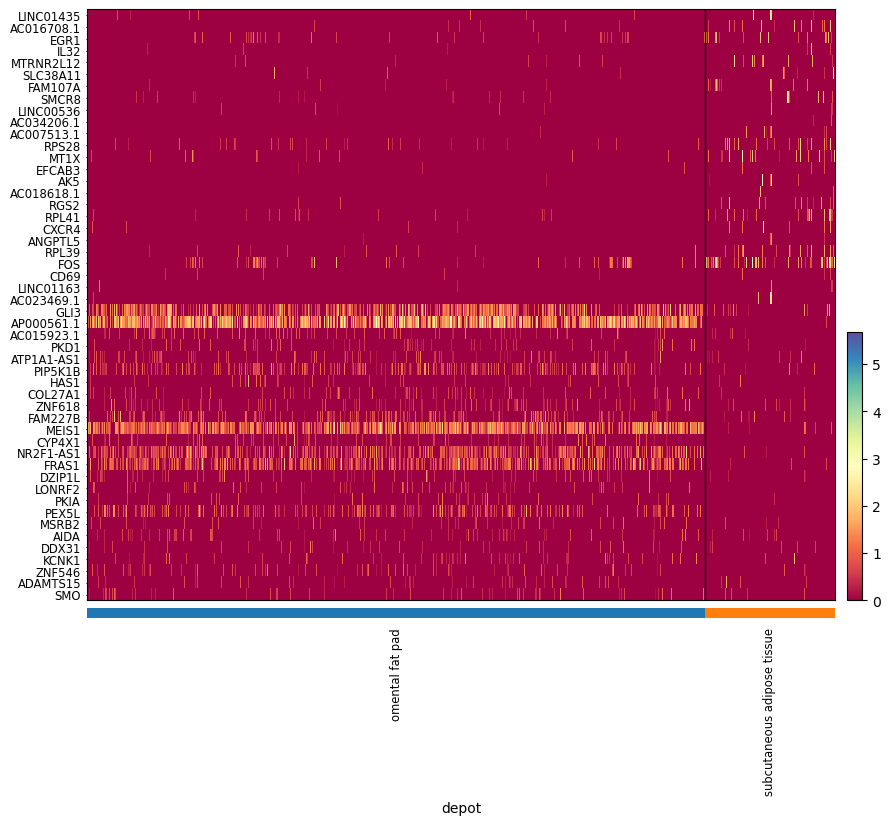

In [32]:
custom_palette = sns.color_palette("Spectral", as_cmap=True)

sc.pl.heatmap(
    macrophages,
    genes_to_show,
    groupby='depot',  # Use appropriate grouping
    swap_axes=True,
    cmap=custom_palette,  # Custom color palette
    figsize=(10, 8),  # Set figure size
    show_gene_labels=True,  # Show gene labels
)

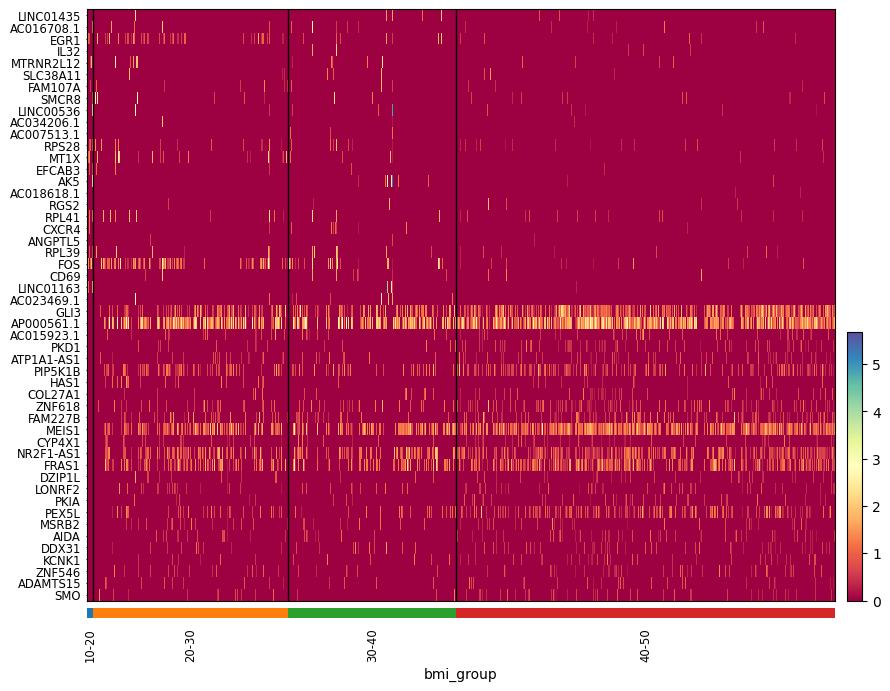

In [39]:
custom_palette = sns.color_palette("Spectral", as_cmap=True)

sc.pl.heatmap(
    macrophages,
    genes_to_show,
    groupby='bmi_group',  # Use appropriate grouping
    swap_axes=True,
    cmap=custom_palette,  # Custom color palette
    figsize=(10, 8),  # Set figure size
    show_gene_labels=True, # Show gene labels
    save='differential_expression_heatmap.png'  # This saves the figure
)

## GO enrichment

In [55]:
import gseapy as gp

In [57]:
# using this library we get access to lots of possible gene libraries

# gp.get_library_name()
# the most common 'GO_Biological_Process_2021' or 'KEGG_2021_Human'

In [60]:
# from the DE df we need to only catch the upregulated genes 
gene_list = dedf[dedf.log2fc > 0].gene.tolist()
len(gene_list)

4759

In [63]:
# then we take this gene list and pass it to the gspy enrich function

enr = gp.enrichr(gene_list=gene_list, # or "./tests/data/gene_list.txt",
                 gene_sets=['KEGG_2021_Human','GO_Biological_Process_2021'],
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                 background= macrophages.var_names.tolist()
                )

In [65]:
enr.results

,Gene_set,Term,P-value,Adjusted P-value,Old P-value,Old adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2021_Human,Lysine degradation,0.000642,0.203007,0,0,2.716162,1.996449e+01,KMT2D;COLGALT2;SETD2;EHMT2;KMT2C;SETD7;PLOD3;D...
1,KEGG_2021_Human,Hedgehog signaling pathway,0.001553,0.245361,0,0,2.793983,1.807041e+01,GSK3B;HHIP;CUL1;ARRB1;GLI3;GLI2;HHAT;GRK3;CCND...
2,KEGG_2021_Human,"Valine, leucine and isoleucine degradation",0.014199,0.999996,0,0,2.208367,9.395733e+00,MCCC2;ACAA2;HIBADH;HMGCS1;BCKDHB;MCCC1;ABAT;AC...
3,KEGG_2021_Human,Propanoate metabolism,0.014589,0.999996,0,0,2.524426,1.067206e+01,ACSS3;ACSS2;BCKDHB;ABAT;ACACA;ACAT2;ACAT1;MCEE...
4,KEGG_2021_Human,Tryptophan metabolism,0.017627,0.999996,0,0,2.732448,1.103453e+01,MAOA;DLST;KMO;ACAT2;INMT;ACAT1;DHTKD1;ALDH3A2;...
...,...,...,...,...,...,...,...,...,...
5802,GO_Biological_Process_2021,mitochondrial ATP synthesis coupled electron t...,0.999996,0.999997,0,0,0.150574,5.913205e-07,COX15;NDUFS4;AFG1L;NDUFS1;SDHD;UQCRC2;NDUFAF1
5803,GO_Biological_Process_2021,aerobic electron transport chain (GO:0019646),0.999996,0.999997,0,0,0.153390,5.991777e-07,COX15;NDUFS4;AFG1L;NDUFS1;SDHD;UQCRC2;NDUFAF1
5804,GO_Biological_Process_2021,ribosomal large subunit biogenesis (GO:0042273),0.999996,0.999997,0,0,0.157991,5.855332e-07,MRPL1;NOP2;MALSU1;NOC2L;WDR12;RRP15
5805,GO_Biological_Process_2021,"mitochondrial electron transport, NADH to ubiq...",0.999997,0.999997,0,0,0.107883,3.644316e-07,NDUFS4;NDUFS1;NDUFAF1


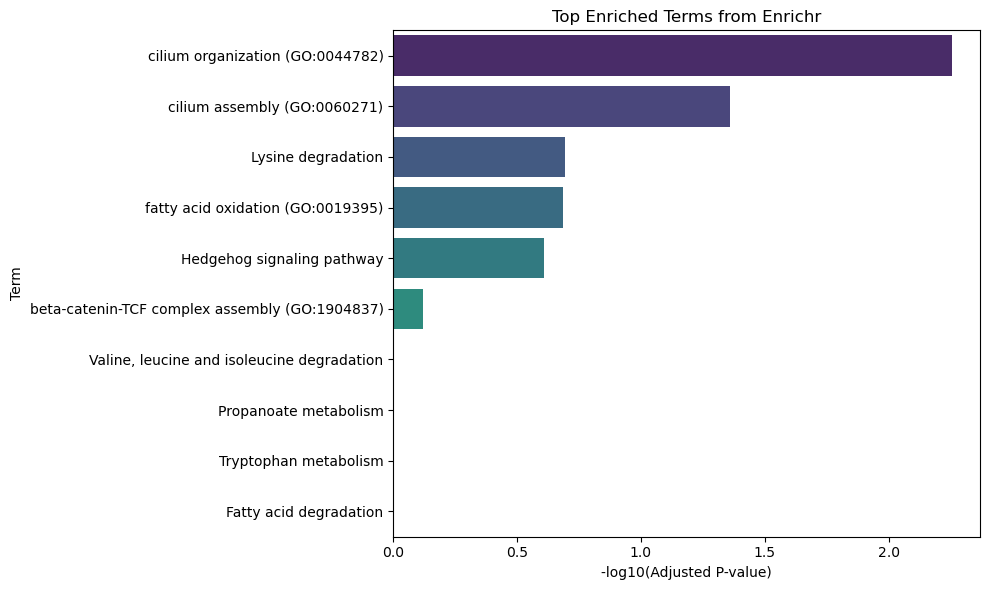

In [72]:
results_df = enr.results

top_n = 10  
top_results = results_df.nsmallest(top_n, 'Adjusted P-value')  

# plotting with seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x=-np.log10(top_results['Adjusted P-value']), y=top_results['Term'], palette='viridis')
plt.xlabel('-log10(Adjusted P-value)')
plt.title('Top Enriched Terms from Enrichr')
plt.tight_layout()
plt.savefig('enrichment_results.png', dpi=300, bbox_inches='tight')
plt.show()

## Comparisons

In [75]:
macrophages

AnnData object with n_obs × n_vars = 40331 × 10436
    obs: 'Sample', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'LAM_cells', 'doublet', 'doublet_score', 'low_label', 'low_score', '_scvi_batch', '_scvi_labels', 'leiden', 'scvi_leiden', 'scvi_cluster_label', 'scvi_louvain', '_scvi_raw_norm_scaling', 'cell_type', 'biosample_type', 'library_preparation_protocol', 'donor_id', 'species', 'organ', 'tissue', 'depot', 'sex', 'race', 'ethnicity', 'disease', 'bmi_value', 'bmi_group', 'age'
    var: 'n_cells'
    uns: 'Sample_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'low_label_colors', 'low_major_colors', 'markers', 'neighbors', 'pca', 'rank_genes_groups', 'scvi_cluster_label_colors', 'scvi_leiden', 'scvi_leiden_colors', 'scvi_louvain', 'scvi_louvain_colors', 'scvi_markers', 'umap', 'bmi_group_colors', 

In [91]:
del macrophages.obs['LAM_cells']

In [126]:
lam_markers = ['TREM2', 'LPL', 'CD9', 'SPP1', 'GPNMB', 'APOE', 'LIPA', 'CTSB', 'CTSL', 'FABP4', 'FABP5', 'LGALS1', 'LGALS3', 'CD36', 'PLIN2', 'ANXA1', 'MMP12']

lam_present_markers = [gene for gene in lam_markers if gene in macrophages.var_names]

lam_present_markers

['LPL',
 'CD9',
 'GPNMB',
 'APOE',
 'LIPA',
 'CTSB',
 'CTSL',
 'FABP4',
 'FABP5',
 'LGALS1',
 'LGALS3',
 'CD36',
 'PLIN2',
 'ANXA1']

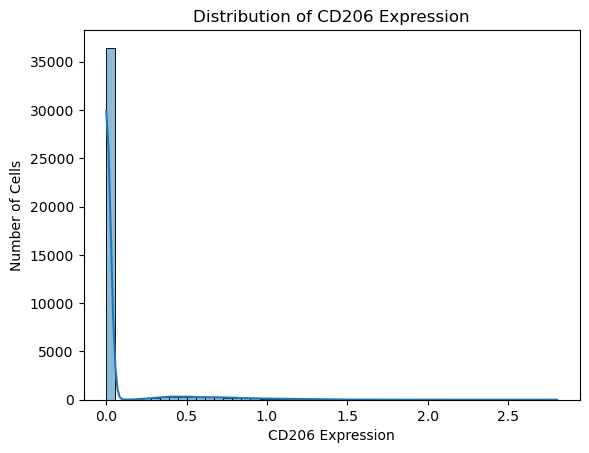

In [118]:
sns.histplot(macrophages[:, 'LPL'].X.flatten(), bins=50, kde=True)
plt.xlabel('CD206 Expression')
plt.ylabel('Number of Cells')
plt.title('Distribution of CD206 Expression')
plt.show()

In [127]:
macrophages.obs['LAM_cells'] = (macrophages[:, lam_present_markers].X > 0.4).any(axis=1)  

lam_cell_counts = macrophages.obs['LAM_cells'].value_counts()

lam_cell_counts

LAM_cells
True     34572
False     5759
Name: count, dtype: int64

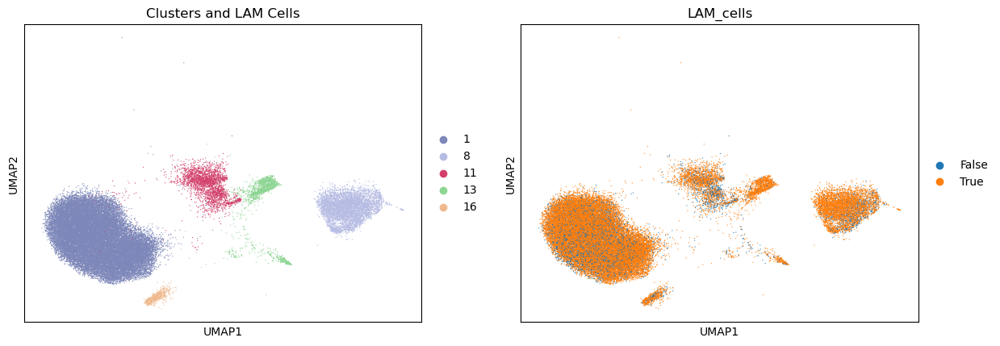

In [128]:
sc.pl.umap(macrophages, color=['leiden', 'LAM_cells'], title='Clusters and LAM Cells')

In [129]:
macrophages.obs['cell_type'].unique()

['Macrophages']
Categories (1, object): ['Macrophages']

<Axes: title={'center': 'LAM Cell Counts and Total Macrophages by BMI Group'}, xlabel='bmi_group'>

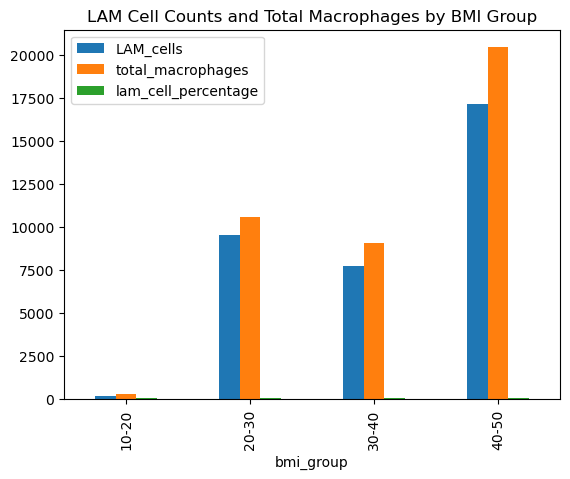

In [130]:
# Count LAM cells by BMI group
bmi_counts = macrophages.obs.groupby('bmi_group').agg({
    'LAM_cells': 'sum',  # Sum of LAM cells in each BMI group
    'Sample': 'count'     # Count of total macrophages in each BMI group
}).rename(columns={'Sample': 'total_macrophages'})

# Calculate the percentage of LAM cells
bmi_counts['lam_cell_percentage'] = (bmi_counts['LAM_cells'] / bmi_counts['total_macrophages']) * 100

# Plotting
bmi_counts[['LAM_cells', 'total_macrophages', 'lam_cell_percentage']].plot(kind='bar', title='LAM Cell Counts and Total Macrophages by BMI Group')

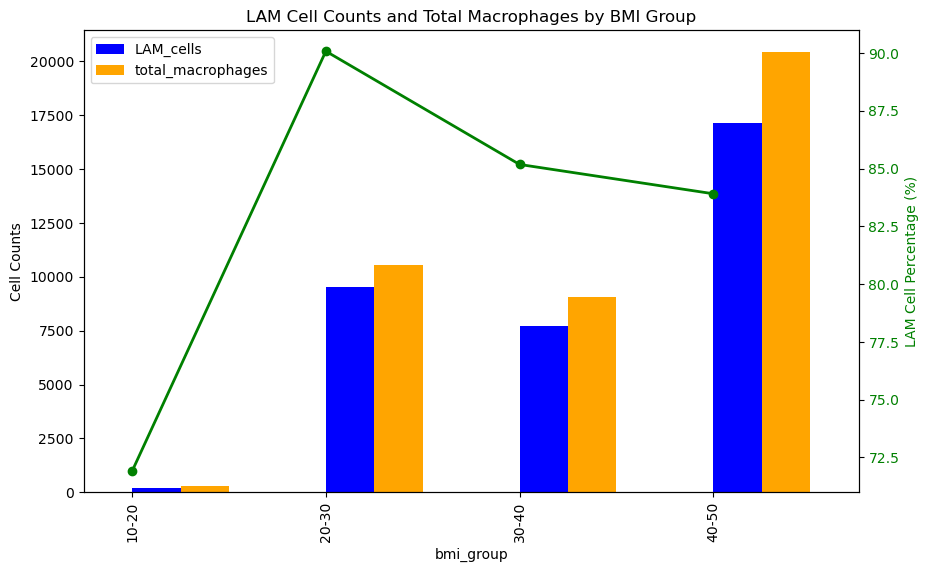

In [134]:
# plotting
fig, ax1 = plt.subplots(figsize=(10, 6))

# plotting LAM cell and total macrophage counts
bmi_counts[['LAM_cells', 'total_macrophages']].plot(kind='bar', ax=ax1, position=0, color=['blue', 'orange'])
ax1.set_ylabel('Cell Counts', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax1.set_title('LAM Cell Counts and Total Macrophages by BMI Group')

# creating a second y-axis for the LAM cell percentage
ax2 = ax1.twinx()  
bmi_counts['lam_cell_percentage'].plot(kind='line', marker='o', ax=ax2, color='green', linewidth=2)
ax2.set_ylabel('LAM Cell Percentage (%)', color='green')
ax2.tick_params(axis='y', labelcolor='green')

plt.savefig('figures/lam_cell_counts_vs_macrophages.png')
# show plot
plt.xticks(rotation=0)
plt.show()

<Axes: title={'center': 'Average LAM Cell Signature Expression by BMI Group'}, xlabel='bmi_group'>

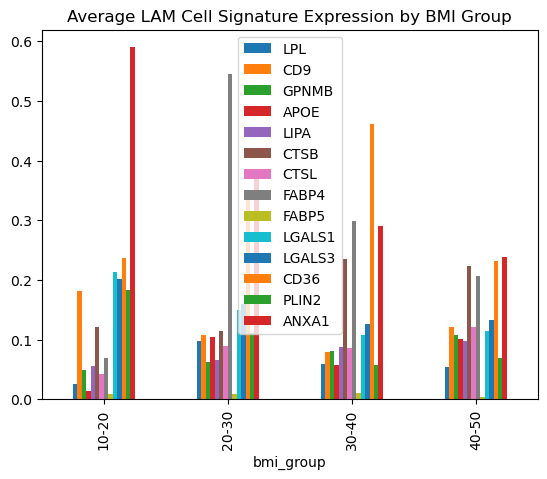

In [137]:
avg_expression = macrophages[:, lam_present_markers].to_df().groupby(macrophages.obs['bmi_group']).mean()


avg_expression.plot(kind='bar', title='Average LAM Cell Signature Expression by BMI Group')

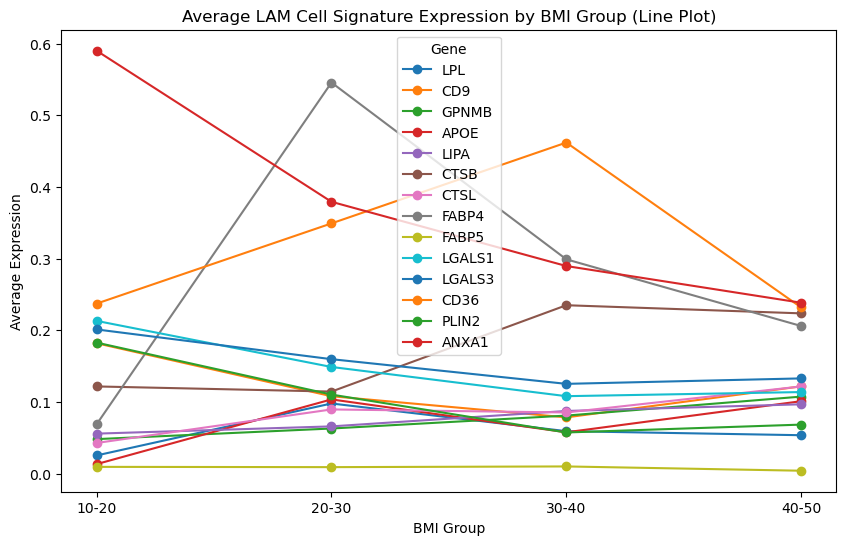

In [145]:
# Plot using line plot
plt.figure(figsize=(10, 6))
for marker in lam_present_markers:
    plt.plot(avg_expression.index, avg_expression[marker], label=marker, marker='o')

# Set plot titles and labels
plt.title('Average LAM Cell Signature Expression by BMI Group (Line Plot)')
plt.xlabel('BMI Group')
plt.ylabel('Average Expression')
plt.legend(title='Gene')

plt.show()


In [153]:
del adata.obs['LAM_cells']

In [155]:
# fidning LAM clusters

# First, let's see what clustering information we have available
print("Available clustering annotations:", 
      [col for col in adata.obs.columns if 'cluster' in col.lower() or 'leiden' in col.lower()])

Available clustering annotations: ['leiden', 'scvi_leiden', 'scvi_cluster_label']


In [156]:
# Let's look at the marker genes for each cluster
# We'll use the leiden clusters
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')

/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:435: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:437: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/adlunglab/miniconda3/envs/scanpy_env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_g


Analyzing expression of LAM markers: ['CD9', 'ABCA1', 'LIPA', 'CD36']


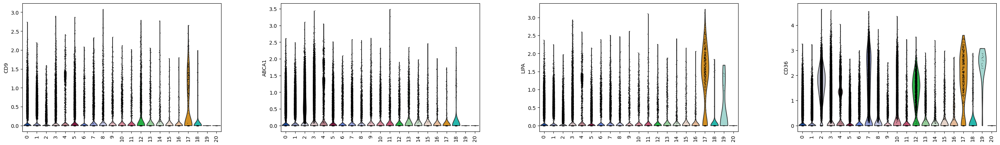

In [157]:
# Create a dataframe of the marker genes
marker_genes_df = sc.get.rank_genes_groups_df(adata, group=None)

# Let's look at the expression of known LAM markers in each cluster
lam_markers = ['CD9', 'ABCA1', 'LIPA', 'CD36']

# Check if these genes are in our dataset (handling potential capitalization differences)
available_genes = [gene for gene in lam_markers 
                  if gene in adata.var_names or gene.upper() in adata.var_names 
                  or gene.lower() in adata.var_names]

print("\nAnalyzing expression of LAM markers:", available_genes)

# Create violin plots for these markers across clusters
sc.pl.violin(adata, available_genes, groupby='leiden', rotation=90)

In [158]:
# Calculate mean expression of LAM markers per cluster
lam_scores = sc.get.obs_df(adata, available_genes)
lam_scores['leiden'] = adata.obs['leiden']
mean_expression = lam_scores.groupby('leiden')[available_genes].mean()

print("\nMean expression of LAM markers in each cluster:")
print(mean_expression)


Mean expression of LAM markers in each cluster:
             CD9     ABCA1      LIPA      CD36
leiden                                        
0       0.091746  0.183626  0.084763  0.250463
1       0.110180  0.235023  0.086180  0.224734
2       0.025816  0.544088  0.059586  1.653310
3       0.079580  0.638954  0.177451  0.868079
4       0.075013  0.366775  0.128617  0.828267
5       0.135440  0.192945  0.069491  0.178320
6       0.036748  0.077300  0.070215  0.288503
7       0.153576  0.146892  0.107889  1.542406
8       0.122767  0.106777  0.085922  0.841562
9       0.095883  0.163916  0.048913  0.133531
10      0.112558  0.178984  0.081781  1.010613
11      0.068527  0.185004  0.077640  0.182555
12      0.351652  0.177409  0.096088  1.229366
13      0.132089  0.357323  0.104047  0.471029
14      0.102376  0.215259  0.085427  0.228440
15      0.069872  0.170189  0.101227  0.335442
16      0.042181  0.105218  0.090792  0.313775
17      0.557802  0.090927  1.329818  1.808783
18      0.0

In [ ]:
# Creating a scoring system based on the expression levels
mean_expr_df = pd.DataFrame({
    'CD9':     [0.091746, 0.110180, 0.025816, 0.079580, 0.075013, 0.135440, 0.036748, 0.153576, 0.122767, 0.095883, 0.112558, 0.068527, 0.351652, 0.132089, 0.102376, 0.069872, 0.042181, 0.557802, 0.043305, 0.000000, 0.000000],
    'ABCA1':   [0.183626, 0.235023, 0.544088, 0.638954, 0.366775, 0.192945, 0.077300, 0.146892, 0.106777, 0.163916, 0.178984, 0.185004, 0.177409, 0.357323, 0.215259, 0.170189, 0.105218, 0.090927, 0.154848, 0.000000, 0.000000],
    'LIPA':    [0.084763, 0.086180, 0.059586, 0.177451, 0.128617, 0.069491, 0.070215, 0.107889, 0.085922, 0.048913, 0.081781, 0.077640, 0.096088, 0.104047, 0.085427, 0.101227, 0.090792, 1.329818, 0.050712, 0.402003, 0.000000],
    'CD36':    [0.250463, 0.224734, 1.653310, 0.868079, 0.828267, 0.178320, 0.288503, 1.542406, 0.841562, 0.133531, 1.010613, 0.182555, 1.229366, 0.471029, 0.228440, 0.335442, 0.313775, 1.808783, 0.297174, 2.377806, 0.000000]
})

# calculating z-scores for each gene
z_scores = (mean_expr_df - mean_expr_df.mean()) / mean_expr_df.std()

# calculating combined score (average z-score across all markers)
combined_scores = z_scores.mean(axis=1)

print("Combined z-scores for each cluster:")
for cluster, score in combined_scores.items():
    print(f"Cluster {cluster}: {score:.3f}")



Analysis of potential LAM clusters:

Number of cells identified as LAM: 50901
Percentage of cells identified as LAM: 26.60%


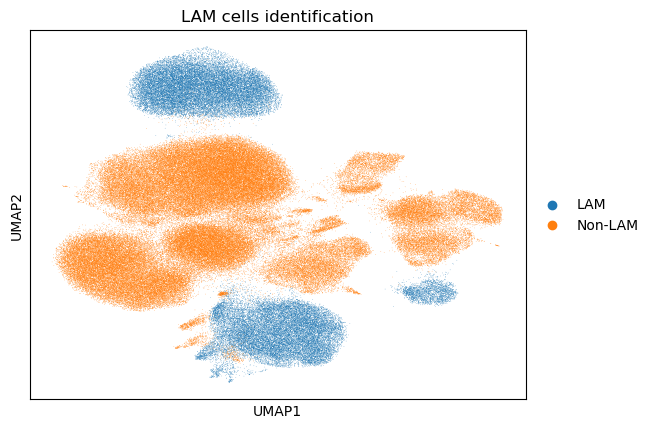

In [159]:
# Based on the expression patterns, let's identify potential LAM clusters
print("\nAnalysis of potential LAM clusters:")

# Let's create the new LAM_cells column
adata.obs['LAM_cells'] = 'Non-LAM'

# Looking at the data, clusters with notably high expression across markers:
# Cluster 17: Highest LIPA, high CD9 and CD36
# Cluster 19: Highest CD36, high LIPA
# Cluster 2: High ABCA1 and CD36
# Cluster 3: Highest ABCA1, elevated across other markers
# Cluster 12: High CD9 and CD36

# Mark these clusters as LAM cells
lam_clusters = [17, 19, 2, 3, 12]  # These seem to be the strongest candidates
adata.obs.loc[adata.obs['leiden'].isin([str(c) for c in lam_clusters]), 'LAM_cells'] = 'LAM'

# Print summary statistics
print("\nNumber of cells identified as LAM:", sum(adata.obs['LAM_cells'] == 'LAM'))
print("Percentage of cells identified as LAM: {:.2f}%".format(
    100 * sum(adata.obs['LAM_cells'] == 'LAM') / len(adata.obs)))

# Visualize the new LAM cell assignments
sc.pl.umap(adata, color='LAM_cells', title='LAM cells identification')

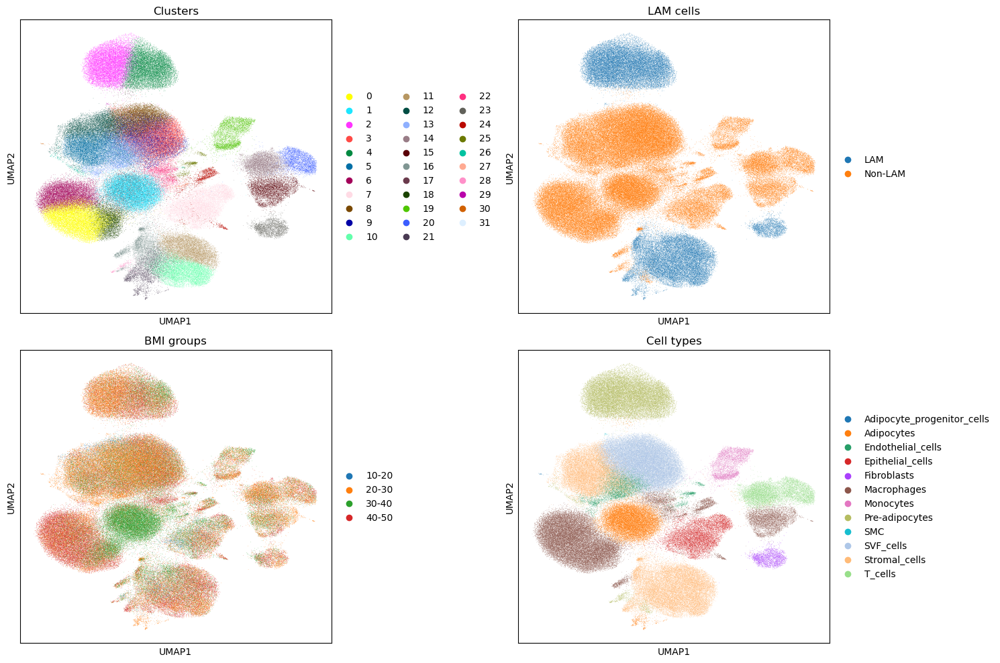


Percentage of LAM cells in each cluster:
LAM_cells    LAM  Non-LAM
leiden                   
0            0.0    100.0
1            0.0    100.0
2          100.0      0.0
3          100.0      0.0
4            0.0    100.0
5            0.0    100.0
6            0.0    100.0
7            0.0    100.0
8            0.0    100.0
9            0.0    100.0
10           0.0    100.0
11           0.0    100.0
12         100.0      0.0
13           0.0    100.0
14           0.0    100.0
15           0.0    100.0
16           0.0    100.0
17         100.0      0.0
18           0.0    100.0
19         100.0      0.0
20           0.0    100.0


In [164]:
# Let's first look at the UMAP visualization colored by different annotations
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 10))

sc.pl.umap(adata, color='scvi_leiden', title='Clusters', ax=ax1, show=False)
sc.pl.umap(adata, color='LAM_cells', title='LAM cells', ax=ax2, show=False)
sc.pl.umap(adata, color='bmi_group', title='BMI groups', ax=ax3, show=False)
sc.pl.umap(adata, color='cell_type', title='Cell types', ax=ax4, show=False)
plt.tight_layout()
plt.show()

# Let's see which clusters have the highest proportion of LAM cells
lam_by_cluster = pd.crosstab(adata.obs['leiden'], adata.obs['LAM_cells'], normalize='index') * 100
print("\nPercentage of LAM cells in each cluster:")
print(lam_by_cluster)

In [165]:
# calculating the proportion of LAM cells per BMI group
lam_by_bmi = pd.crosstab(adata.obs['bmi_group'], adata.obs['LAM_cells'], normalize='index') * 100
print("\nPercentage of LAM cells in each BMI group:")
print(lam_by_bmi)


Percentage of LAM cells in each BMI group:
LAM_cells        LAM    Non-LAM
bmi_group                      
10-20      17.900093  82.099907
20-30      28.132838  71.867162
30-40      20.873544  79.126456
40-50      31.273425  68.726575


In [167]:
adata.obs['LAM_signature_score'] = adata[:, lam_markers].X.mean(axis=1)
adata.obs

,Sample,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,pct_counts_mt,pct_counts_ribo,pct_counts_hb,...,sex,race,ethnicity,disease,bmi_value,bmi_group,age,_scvi_temp_de,LAM_cells,LAM_signature_score
index,,,,,,,,,,,,,,,,,,,,,
AAAAATGACGCA,Hs_SAT_SVF_235-1A-1,756,756,6.629363,1184.0,7.077498,17.483108,3.462838,2.111486,0.084459,...,female,White,European,normal,36.04,30-40,53,None,LAM,0.000000
AAAAGGAAAGAA,Hs_SAT_SVF_235-1A-1,293,293,5.683580,391.0,5.971262,21.994885,3.324808,1.278772,0.000000,...,female,White,European,normal,36.04,30-40,53,None,Non-LAM,0.000000
AAAAGGCGACGT,Hs_SAT_SVF_235-1A-1,727,727,6.590301,1224.0,7.110696,16.013072,3.431373,8.660131,0.000000,...,female,White,European,normal,36.04,30-40,53,None,Non-LAM,0.605773
AAAAGTTATGAT,Hs_SAT_SVF_235-1A-1,205,205,5.327876,291.0,5.676754,29.896907,3.092783,1.030928,0.000000,...,female,White,European,normal,36.04,30-40,53,None,Non-LAM,0.000000
AAAATCGGTCCA,Hs_SAT_SVF_235-1A-1,426,426,6.056784,731.0,6.595780,22.024624,3.830369,6.429549,0.000000,...,female,White,European,normal,36.04,30-40,53,None,Non-LAM,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAATGCGG,Hs_SAT_266-1,2838,2838,7.951207,6552.0,8.787679,22.268010,2.029915,0.366300,0.000000,...,male,White,European,normal,22.15,20-30,68,two,Non-LAM,0.063235
TTTGTTGGTCGTGTTA,Hs_SAT_266-1,994,994,6.902743,1639.0,7.402452,17.998780,1.342282,0.366077,0.000000,...,male,White,European,normal,22.15,20-30,68,two,Non-LAM,0.426846
TTTGTTGGTTCTCTCG,Hs_SAT_266-1,1488,1488,7.305860,2509.0,7.828038,14.228776,1.275409,0.438422,0.000000,...,male,White,European,normal,22.15,20-30,68,two,Non-LAM,0.434363


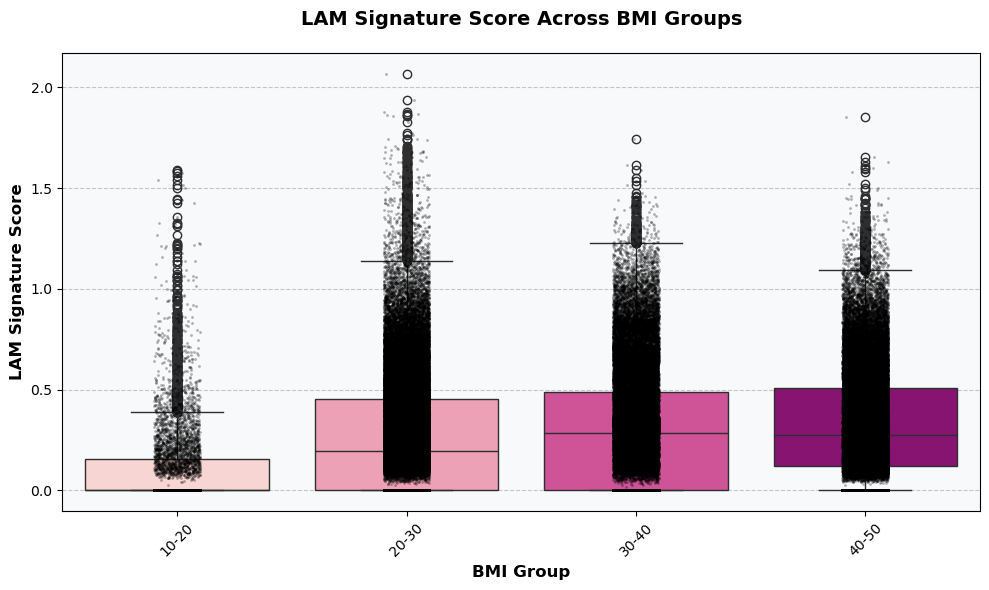


Mean LAM signature score per BMI group:
bmi_group
10-20    0.099862
20-30    0.267896
30-40    0.304351
40-50    0.327995
Name: LAM_signature_score, dtype: float32


In [187]:
colors = sns.color_palette("RdPu", n_colors=4)

plt.figure(figsize=(10, 6))

# Boxplot
sns.boxplot(data=adata.obs, x='bmi_group', y='LAM_signature_score', 
            palette=colors)

# Stripplot (overlay)
sns.stripplot(data=adata.obs, x='bmi_group', y='LAM_signature_score', 
              color='black', size=2, alpha=0.3)

# Title and labels
plt.title('LAM Signature Score Across BMI Groups', fontsize=14, fontweight='bold', pad=20)
plt.xlabel('BMI Group', fontsize=12, fontweight='bold')
plt.ylabel('LAM Signature Score', fontsize=12, fontweight='bold')

# Rotate x-axis labels for readability
plt.xticks(rotation=45, fontsize=10)

# Gridlines
plt.grid(True, axis='y', linestyle='--', alpha=0.7)

# Set facecolor for the background
plt.gca().set_facecolor('#f8f9fa')

# Tight layout to avoid overlap
plt.tight_layout()

# Show the plot
plt.show()

# Optional: Print summary statistics
print("\nMean LAM signature score per BMI group:")
print(adata.obs.groupby('bmi_group')['LAM_signature_score'].mean())


In [173]:
# Perform Kruskal-Wallis H-test
groups = [group for _, group in adata.obs.groupby('bmi_group')['LAM_signature_score']]
h_stat, p_val = stats.kruskal(*groups)
print(f"\nKruskal-Wallis test:")
print(f"H-statistic: {h_stat:.4f}")
print(f"p-value: {p_val:.4e}")


Kruskal-Wallis test:
H-statistic: 6196.1837
p-value: 0.0000e+00


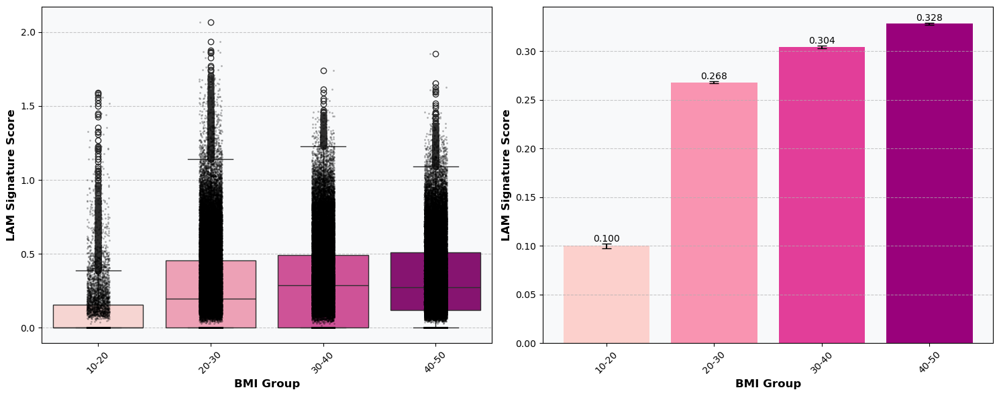

In [188]:
colors = sns.color_palette("RdPu", n_colors=4)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

sns.boxplot(data=adata.obs, x='bmi_group', y='LAM_signature_score', 
            palette=colors, ax=ax1)
sns.stripplot(data=adata.obs, x='bmi_group', y='LAM_signature_score', 
              color='black', size=2, alpha=0.3, ax=ax1)

# Enhanced bar plot
mean_scores = adata.obs.groupby('bmi_group')['LAM_signature_score'].mean()
std_error = adata.obs.groupby('bmi_group')['LAM_signature_score'].std() / \
            np.sqrt(adata.obs.groupby('bmi_group').size())

bars = ax2.bar(mean_scores.index, mean_scores.values, yerr=std_error, 
               capsize=5, color=colors)

# some fancy elements
# adding value labels on top of bars
for i, bar in enumerate(bars):
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + std_error[i],
             f'{height:.3f}',
             ha='center', va='bottom')

# customizing the plots
for ax in [ax1, ax2]:
    ax.set_xlabel('BMI Group', fontsize=12, fontweight='bold')
    ax.set_ylabel('LAM Signature Score', fontsize=12, fontweight='bold')
    ax.tick_params(axis='both', which='major', labelsize=10)
    ax.set_title(ax.get_title(), fontsize=14, fontweight='bold', pad=20)
    
    # adding grid
    ax.grid(True, axis='y', linestyle='--', alpha=0.7)
    
    # rotate x-labels
    ax.tick_params(axis='x', rotation=45)

for ax in [ax1, ax2]:
    ax.set_facecolor('#f8f9fa') 
plt.savefig('figures/lam_signature_scores.png')  
plt.tight_layout()
plt.show()

In [175]:
# Print additional statistical information
print("\nSummary Statistics by BMI Group:")
print(adata.obs.groupby('bmi_group')['LAM_signature_score'].describe())

# Calculate and print percentage changes between consecutive groups
prev_value = None
print("\nPercentage changes between consecutive BMI groups:")
for group, value in mean_scores.items():
   if prev_value is not None:
       pct_change = ((value - prev_value) / prev_value) * 100
       print(f"{prev_group} to {group}: {pct_change:.1f}%")
   prev_value = value
   prev_group = group


Summary Statistics by BMI Group:
             count      mean       std  min       25%       50%       75%  \
bmi_group                                                                   
10-20       6486.0  0.099862  0.185081  0.0  0.000000  0.000000  0.155671   
20-30      71365.0  0.267896  0.288585  0.0  0.000000  0.196717  0.455798   
30-40      56162.0  0.304351  0.294419  0.0  0.000000  0.286811  0.490785   
40-50      57365.0  0.327995  0.268291  0.0  0.121293  0.275467  0.509850   

                max  
bmi_group            
10-20      1.589885  
20-30      2.068132  
30-40      1.741606  
40-50      1.854698  

Percentage changes between consecutive BMI groups:
10-20 to 20-30: 168.3%
20-30 to 30-40: 13.6%
30-40 to 40-50: 7.8%
